In [1]:
import cv2
import matplotlib.pyplot as plt
import cvlib as cv
import os
from cvlib.object_detection import draw_bbox
import time

Using TensorFlow backend.


In [2]:
path = "/home/aman/Documents/Project/DepthCal/Code/Data/"

In [3]:
right = path + "right/"
left = path + "left/"

In [4]:
f = []
for (root,dirs,files) in os.walk(right, topdown=True):
    f.append(files)

In [5]:
files.sort()

In [6]:
files

['frame0001.jpg',
 'frame0003.jpg',
 'frame0005.jpg',
 'frame0007.jpg',
 'frame0009.jpg',
 'frame0011.jpg',
 'frame0013.jpg',
 'frame0015.jpg',
 'frame0017.jpg',
 'frame0019.jpg',
 'frame0021.jpg',
 'frame0023.jpg',
 'frame0025.jpg',
 'frame0027.jpg',
 'frame0029.jpg',
 'frame0031.jpg',
 'frame0033.jpg',
 'frame0035.jpg',
 'frame0037.jpg',
 'frame0039.jpg',
 'frame0041.jpg',
 'frame0043.jpg',
 'frame0045.jpg',
 'frame0047.jpg',
 'frame0049.jpg',
 'frame0051.jpg',
 'frame0053.jpg',
 'frame0055.jpg',
 'frame0057.jpg',
 'frame0059.jpg',
 'frame0061.jpg',
 'frame0063.jpg',
 'frame0065.jpg',
 'frame0067.jpg',
 'frame0069.jpg',
 'frame0071.jpg',
 'frame0073.jpg',
 'frame0075.jpg',
 'frame0077.jpg',
 'frame0079.jpg',
 'frame0081.jpg',
 'frame0083.jpg',
 'frame0085.jpg',
 'frame0087.jpg',
 'frame0089.jpg',
 'frame0091.jpg',
 'frame0093.jpg',
 'frame0095.jpg',
 'frame0097.jpg',
 'frame0099.jpg',
 'frame0101.jpg',
 'frame0103.jpg',
 'frame0105.jpg',
 'frame0107.jpg',
 'frame0109.jpg',
 'frame011

In [7]:
baseline = 60
f = 760  #assumed
flag=0

def depth():
    for i in range(len(files)):
        imgR = cv2.imread(right + files[i])
        bboxR, labelR, confR = cv.detect_common_objects(imgR)
        if len(bboxR)>0 and labelR[0] == 'person' and flag==0:
            a = int(files[i][5:-4])
            a = a-1
            a = str(a)
            a = '{0}'.format(a.zfill(4))
            imgL = cv2.imread(left + files[i][0:5] + a + ".jpg")
            bboxL, labelL, confL = cv.detect_common_objects(imgL)
            
            if len(bboxL) == 0:
                print("Object only in Right Camera")
                plt.imshow(imgR)
                plt.show()
                print("\n")
            else:
                imL = cv2.imread((left + files[i][0:5] + a + ".jpg"), 0)
                imR = cv2.imread((right + files[i]), 0)
                stereo = cv2.StereoBM_create(numDisparities=16, blockSize=15)
                disparity = stereo.compute(imL, imR)
                
                ct = 0
                d = 0
                
                for j in range(bboxR[0][1], bboxR[0][3]):
                    for i in range(bboxR[0][0], bboxR[0][2]):
                        if(disparity[j][i] != 0):
                            d = d+abs(disparity[j][i])
                            ct = ct+1
                    
                d = d/ct

                h = 480
                w = 752
                li = [[0 for x in range(w)] for y in range(h)]

                for j in range(bboxR[0][1], bboxR[0][3]):
                    for i in range(bboxR[0][0], bboxR[0][2]):
                        if(disparity[j][i] != 0):
                            li[j][i] = d
                            
                z = (f*baseline)/d
                print(z)
                
                fig, (orig, disp, avgDisp) = plt.subplots(ncols=3, figsize=(10, 5))
                orig.imshow(imgR, 'gray')
                disp.imshow(disparity, 'gray')
                avgDisp.imshow(li, 'gray')
                plt.show()
                
                print('\n')

                p = bboxR[0][2] - bboxR[0][0]
                w = (z*p)/f
                flag=1
            
        elif len(bboxR)>0 and labelR[0] == 'person' and flag==1:
            p = bboxR[0][2] - bboxR[0][0]
            z = (w*f)/p
            print(z)
            plt.imshow(imgR, 'gray')
            plt.show()
            print('\n')
            
        else:
            print("No Object")
            plt.imshow(imgR)
            plt.show()
            print('\n')
            flag=0

No Object


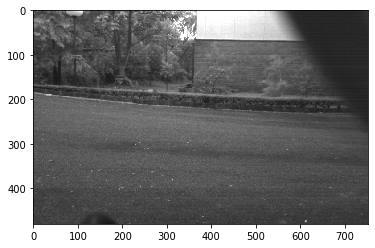



No Object


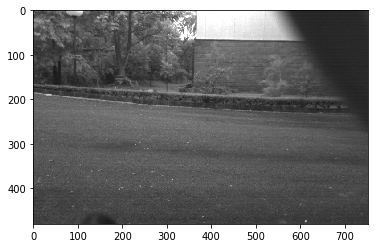



No Object


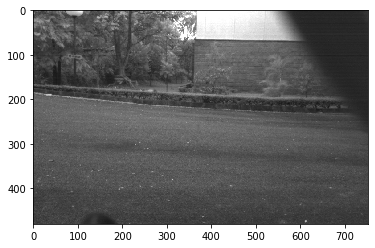



No Object


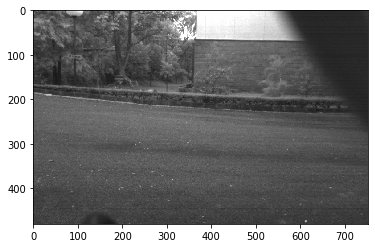



No Object


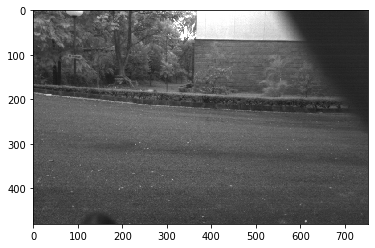



No Object


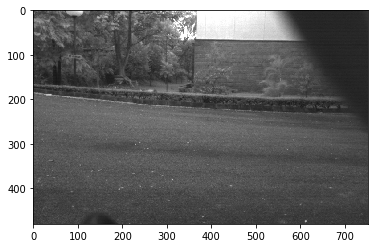



No Object


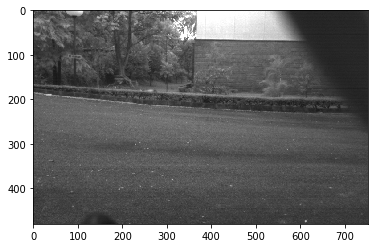



No Object


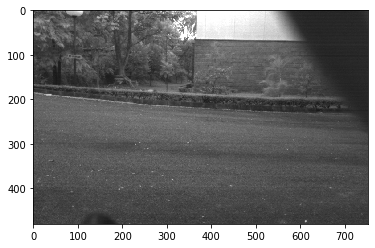



No Object


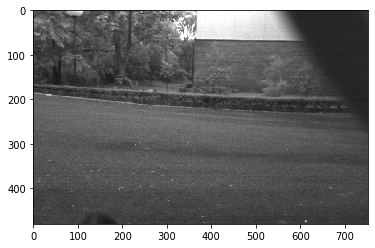



No Object


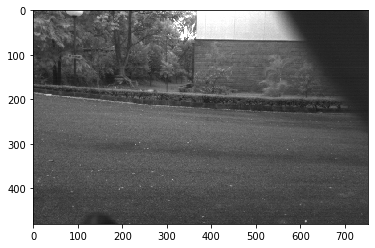



No Object


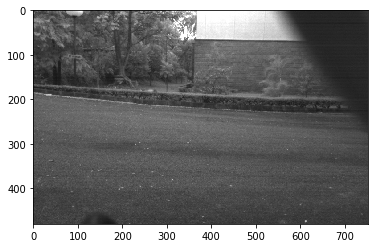



No Object


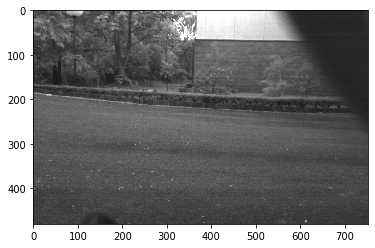



No Object


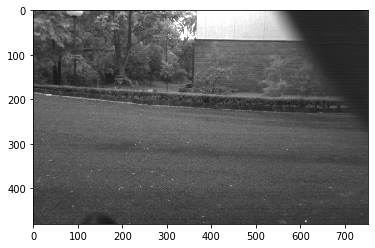



No Object


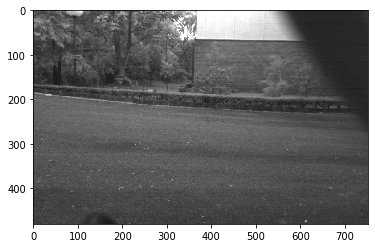



No Object


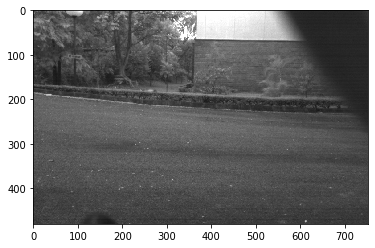



No Object


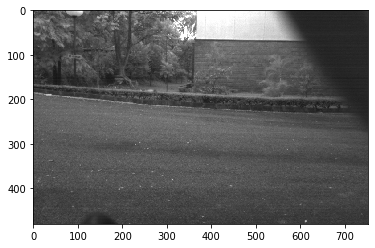



No Object


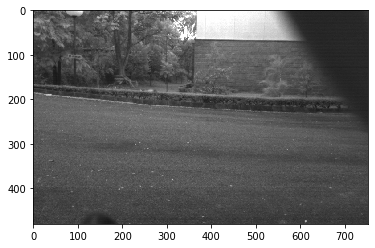



No Object


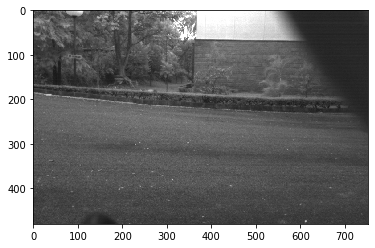



No Object


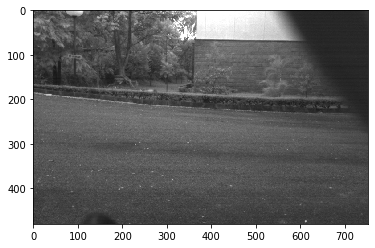



No Object


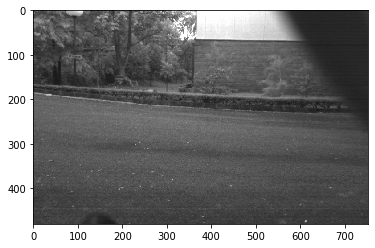



No Object


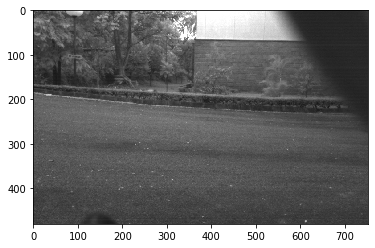



No Object


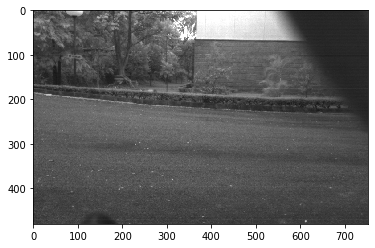



No Object


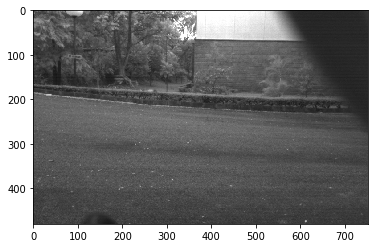



No Object


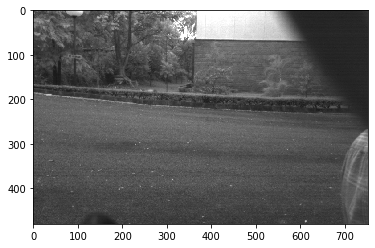



Object only in Right Camera


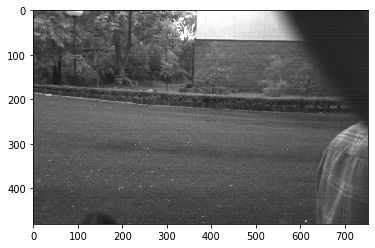



1376.475749097083


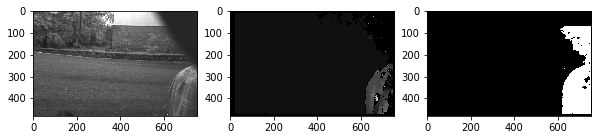



1285.9181340249065


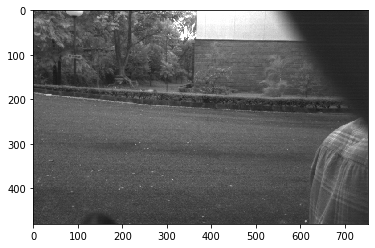



1376.475749097083


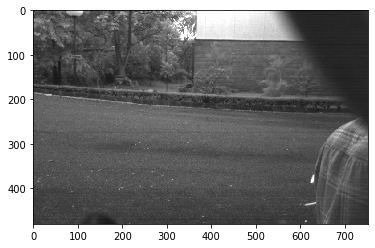



No Object


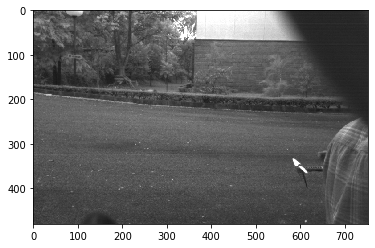



No Object


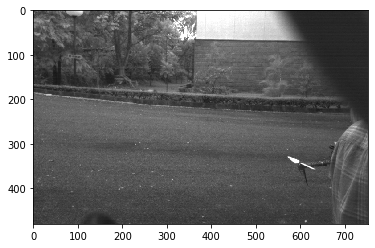



Object only in Right Camera


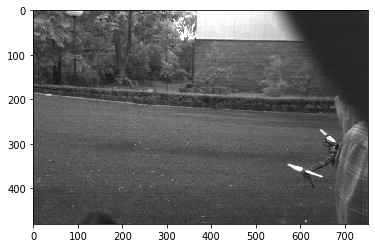



1158.5600615527596


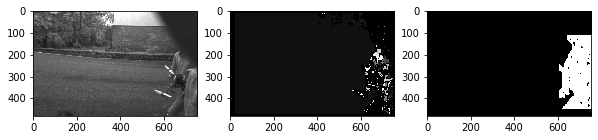



924.3830278346487


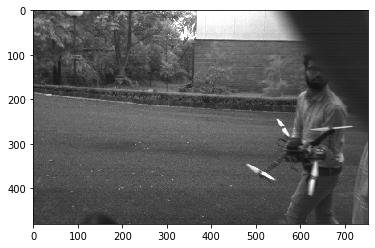



1114.000059185346


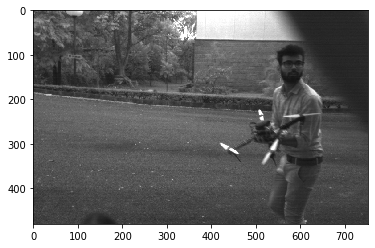



775.8214697897945


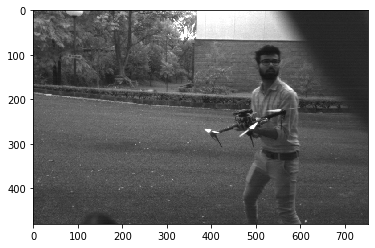



944.4783110484454


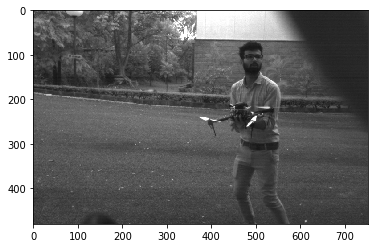



1114.000059185346


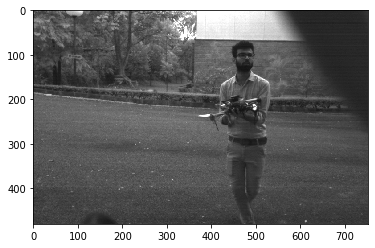



1114.000059185346


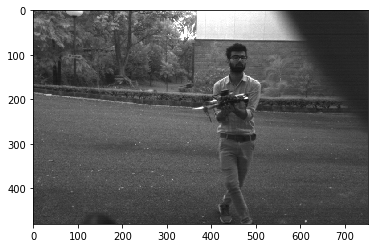



1259.3044147312605


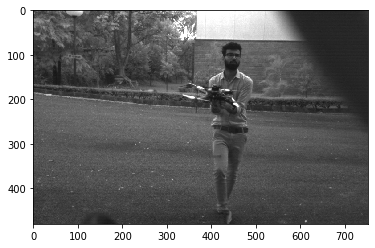



1357.6875721321403


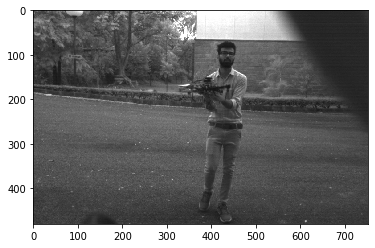



1671.0000887780188


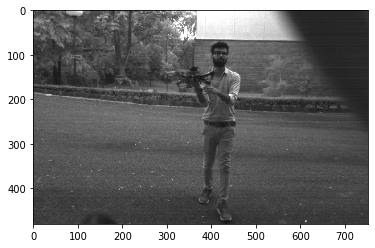



1609.111196601055


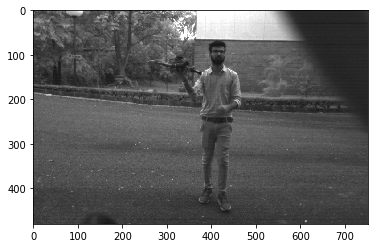



1034.4286263863926


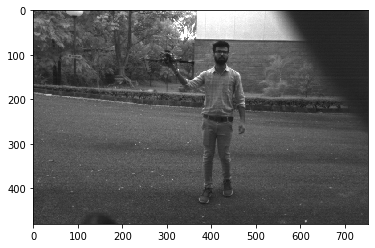



1046.8916218850238


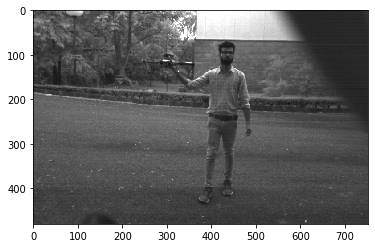



1046.8916218850238


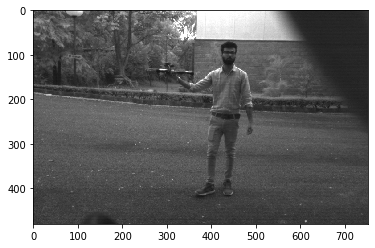



1086.1500577057122


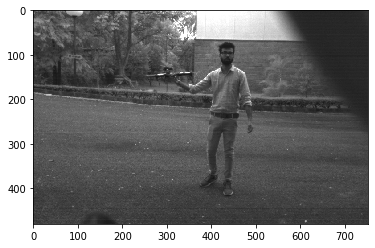



1114.000059185346


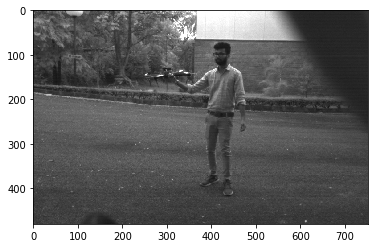



1128.4675924215192


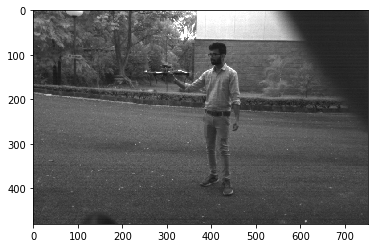



1158.5600615527596


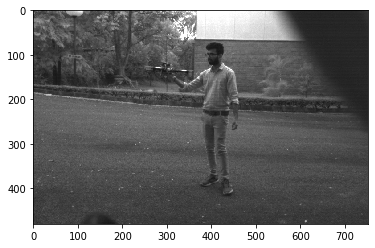



1086.1500577057122


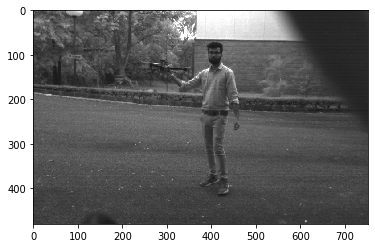



1143.3158502165393


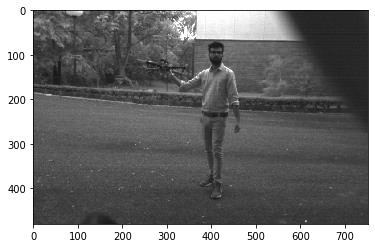



1128.4675924215192


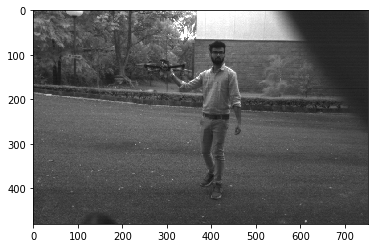



1059.6585928836216


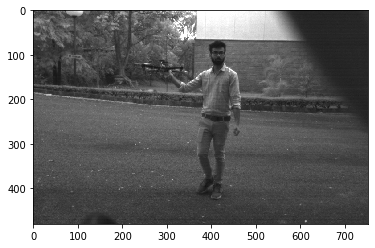



998.7586737523791


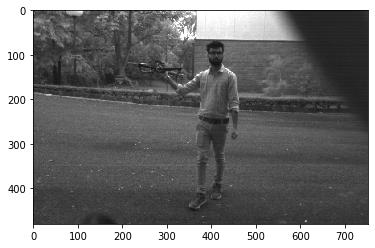



976.3146586118762


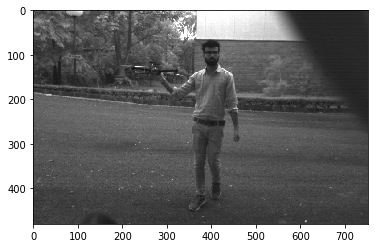



998.7586737523791


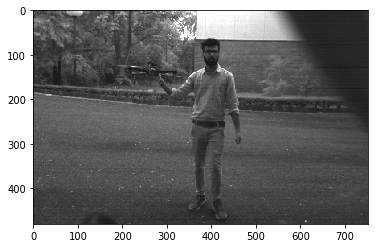



998.7586737523791


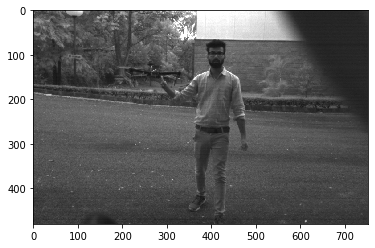



877.6970163278482


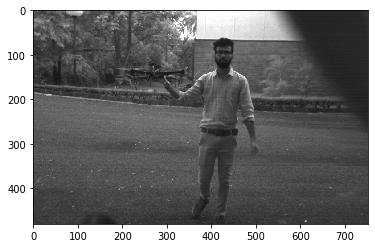



905.1250480880935


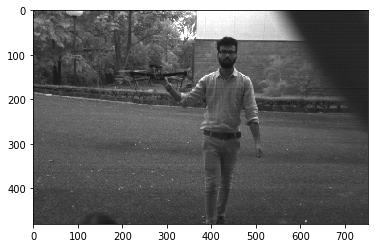



789.9273146950635


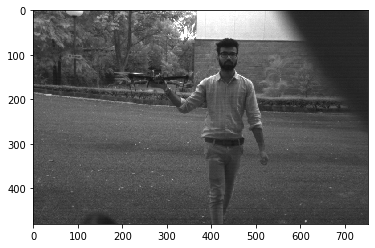



706.4390619224145


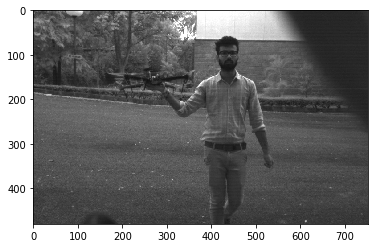



673.5814311353254


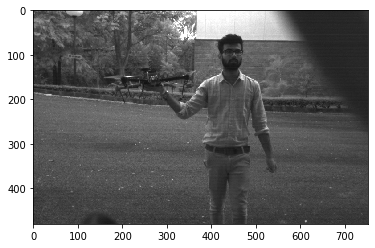



629.6522073656303


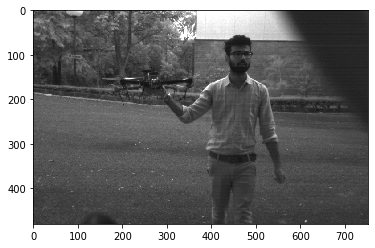



595.1507165510752


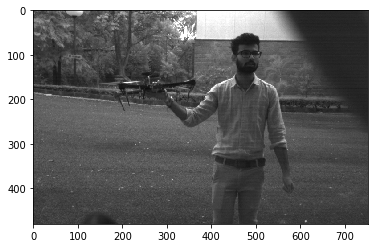



591.1020722207958


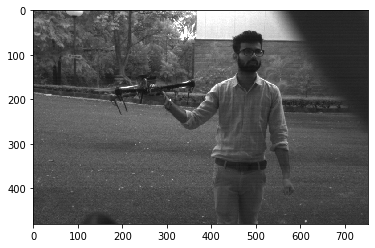



595.1507165510752


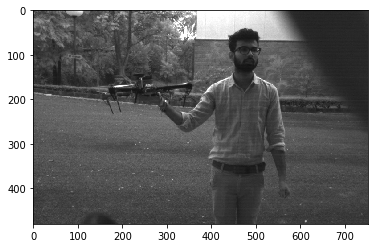



567.9215988003724


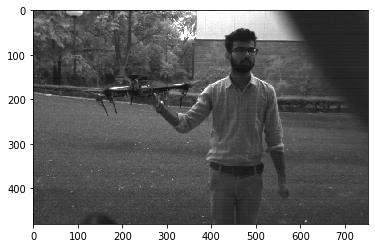



564.2337962107596


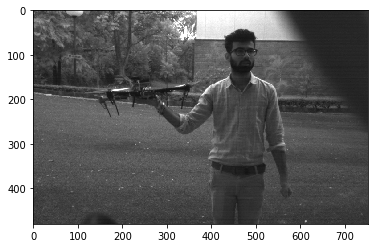



575.4437391818343


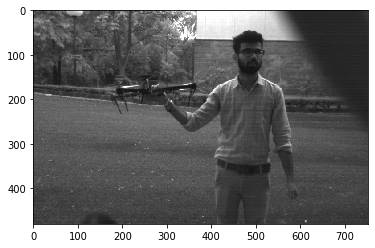



587.108139300385


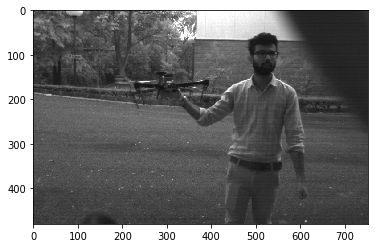



634.2482088792481


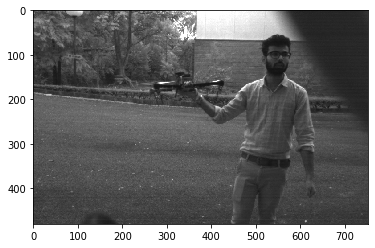



684.1890127280077


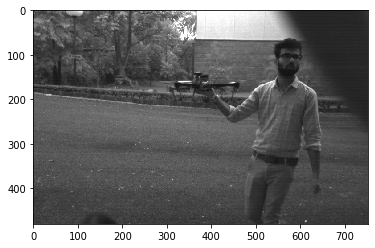



706.4390619224145


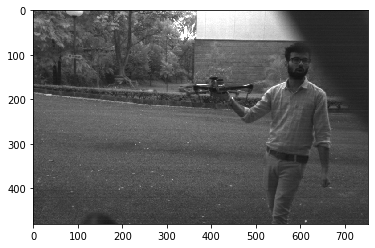



775.8214697897945


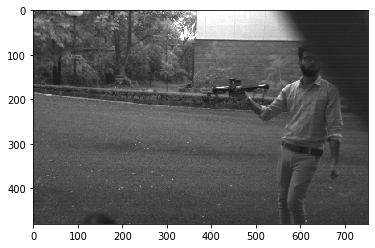



895.7938620253296


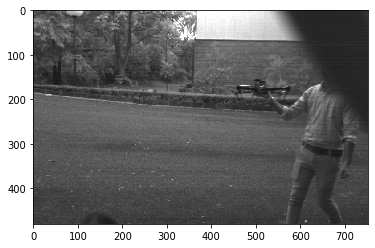



1034.4286263863926


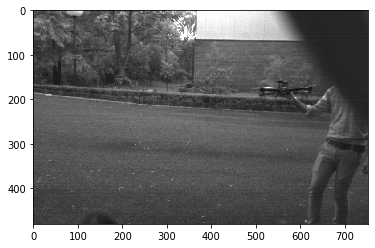



1223.8310509360138


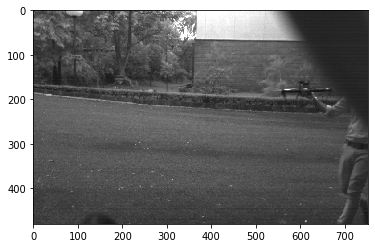



No Object


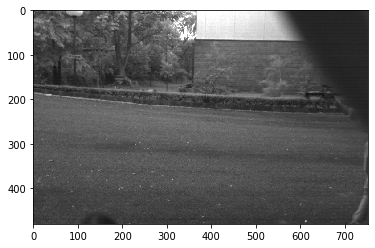



No Object


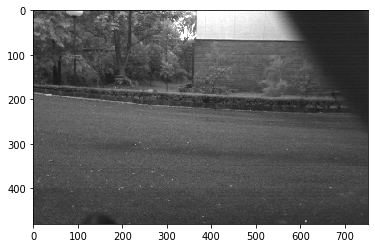



No Object


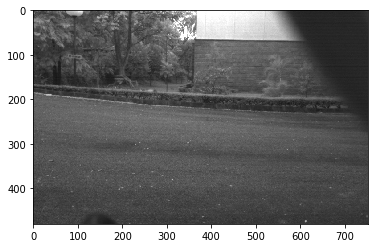



No Object


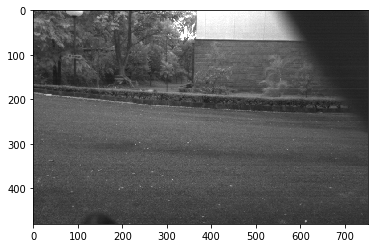



No Object


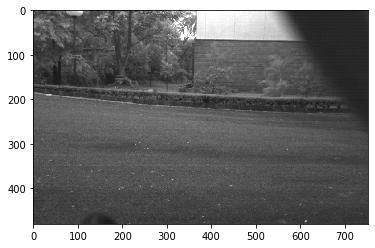



No Object


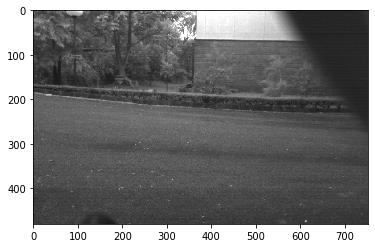



No Object


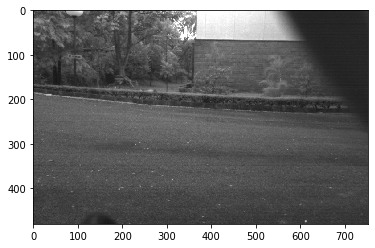



No Object


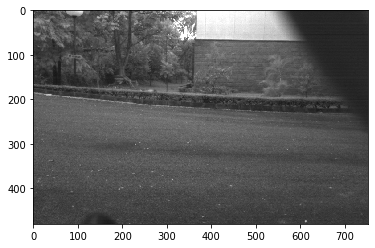



No Object


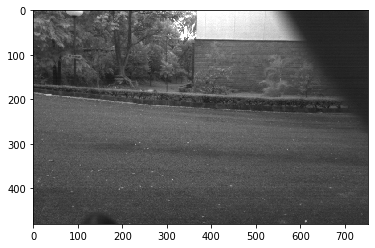



No Object


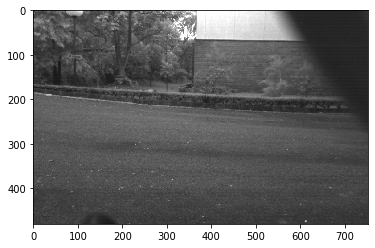



No Object


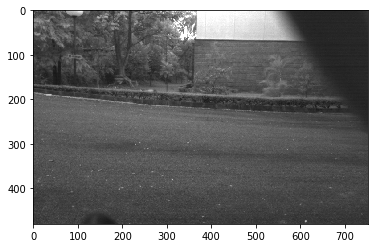



No Object


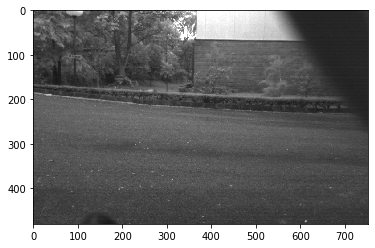



No Object


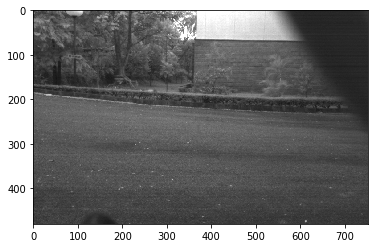



No Object


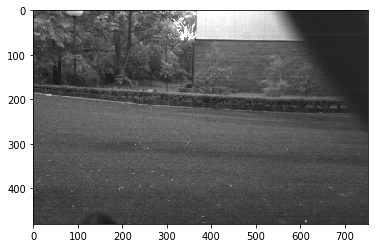



No Object


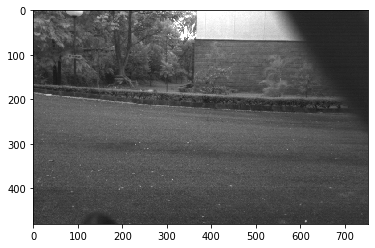



No Object


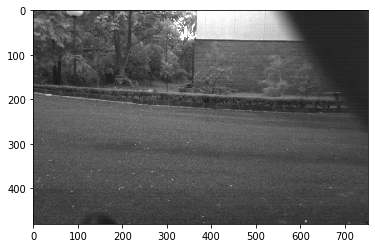



No Object


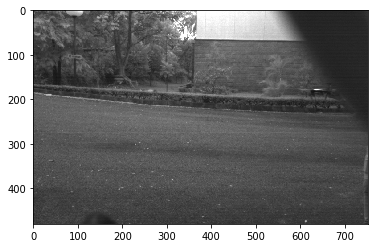



Object only in Right Camera


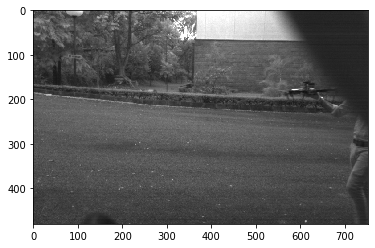



1328.4613419365571


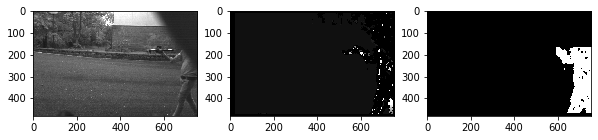



1378.909240997439


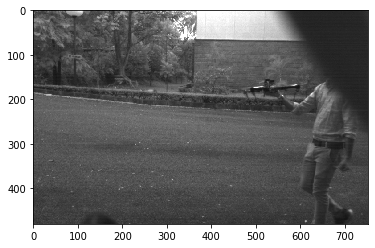



1252.1129889516974


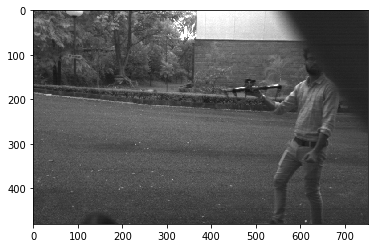



1089.3383003879767


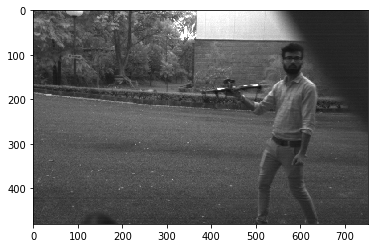



1100.341717563613


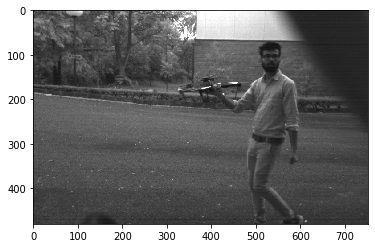



955.5599126210323


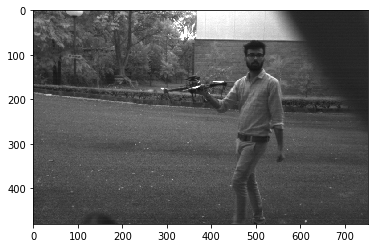



1027.6776418754498


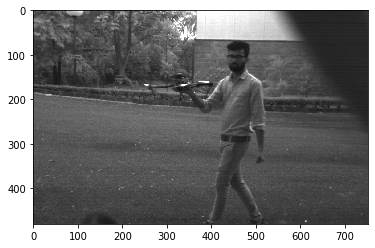



1266.672442311601


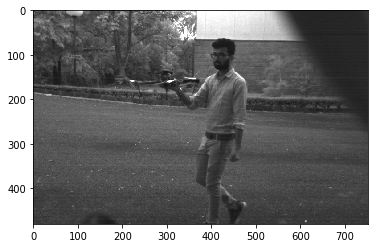



1237.8844322590646


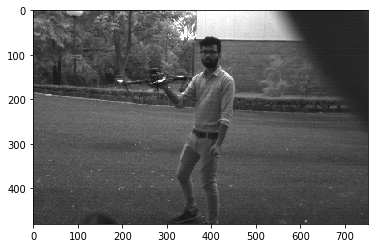



1197.075055371403


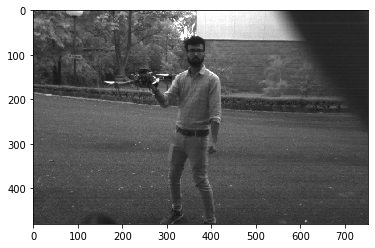



1396.5875645999702


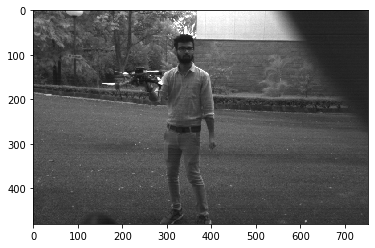



1452.4510671839691


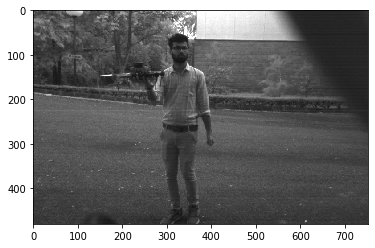



1512.9698616499677


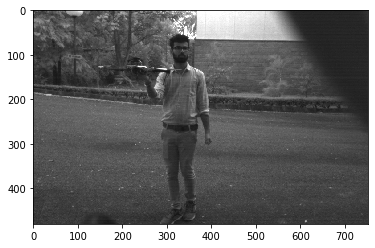



1452.4510671839691


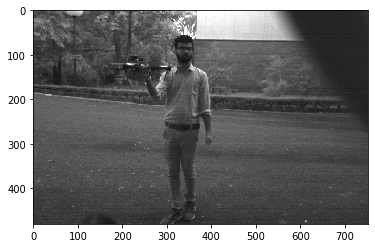



1433.3398689315484


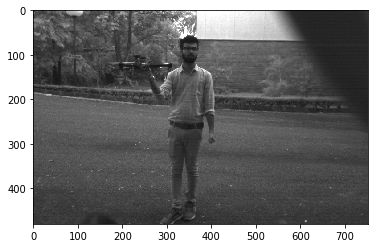



1472.0787843080768


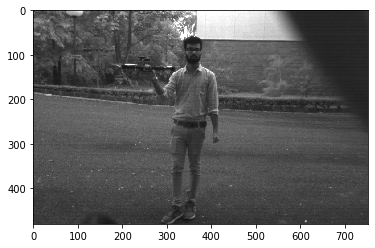



1675.9050775199644


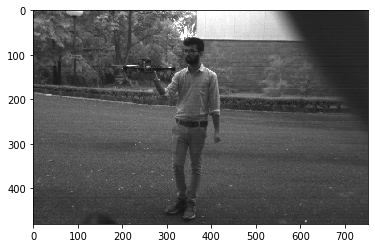



1650.5125763454193


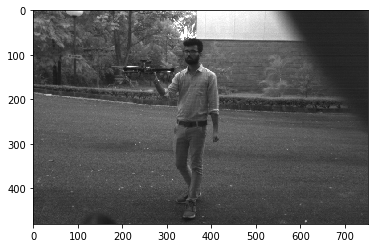



1702.0910943562137


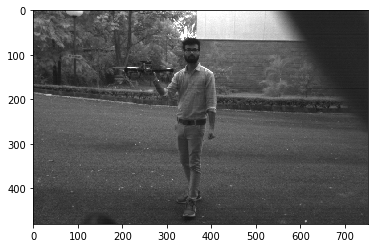



1650.5125763454193


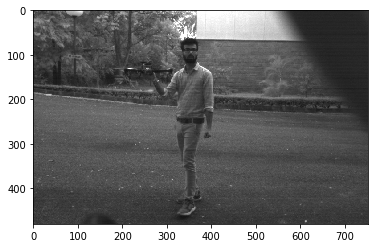



1601.9680888058483


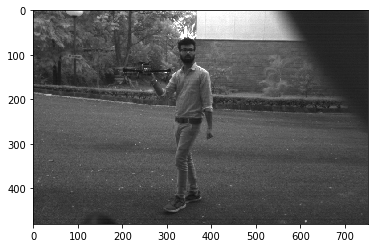



1578.751159982575


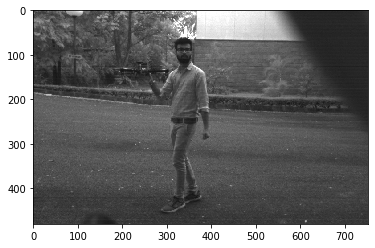



1625.8780602805623


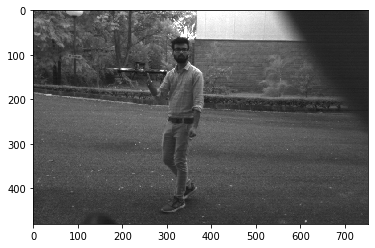



2055.3552837508996


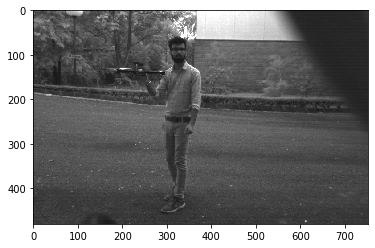



2017.2931488666236


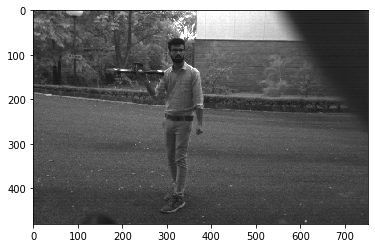



1601.9680888058483


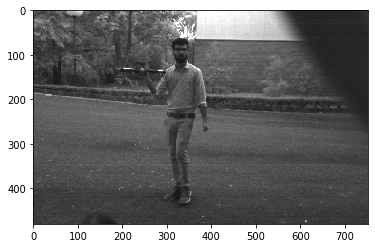



1650.5125763454193


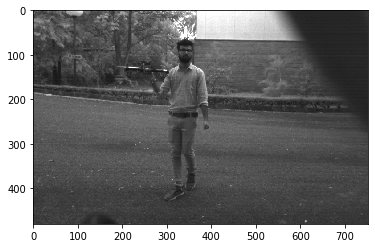



1911.1198252420645


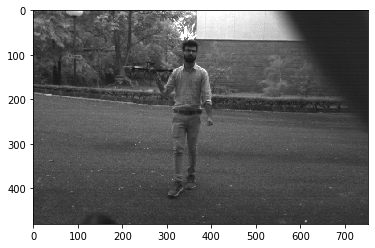



1815.5638339799614


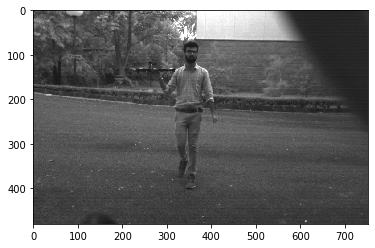



1729.1084133142488


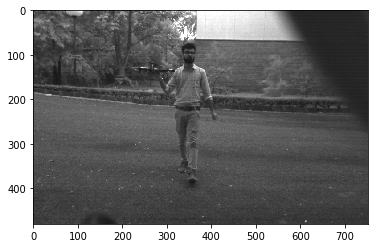



2017.2931488666236


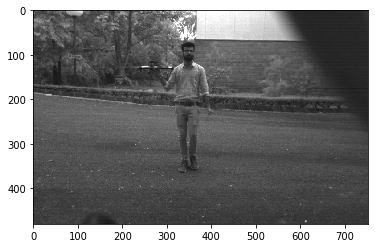



2135.957451741131


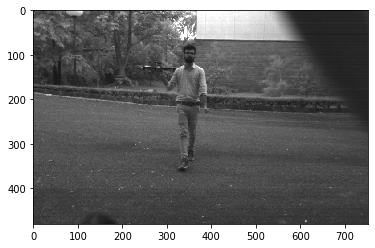



2269.454792474952


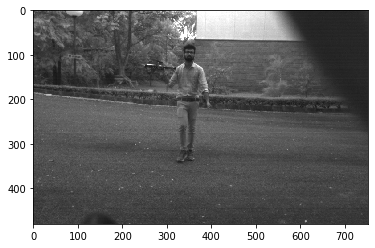



2178.6766007759534


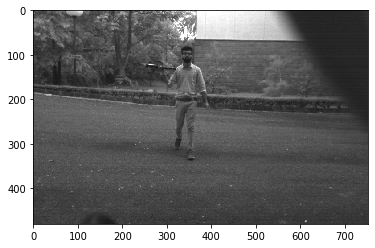



2317.74106465527


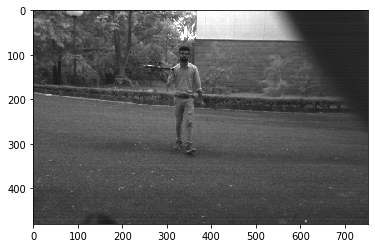



2475.7688645181292


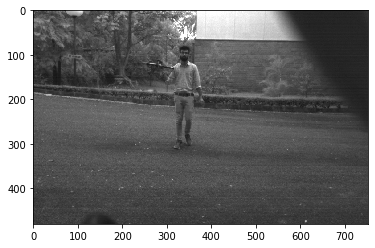



2723.345750969942


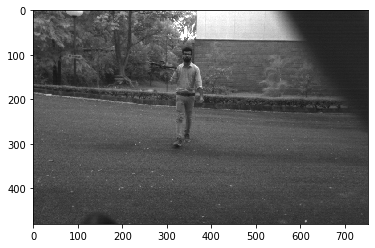



2793.1751291999403


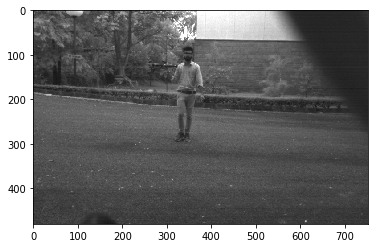



2723.345750969942


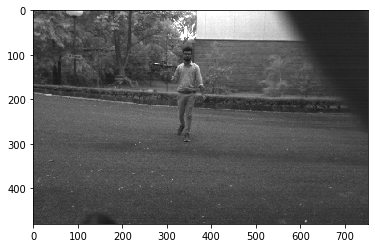



3025.9397232999354


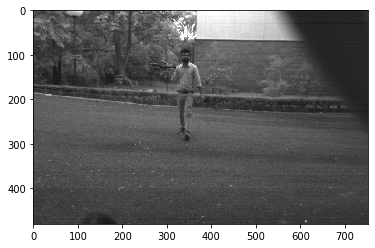



3631.1276679599227


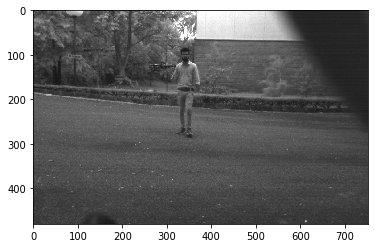



3404.1821887124274


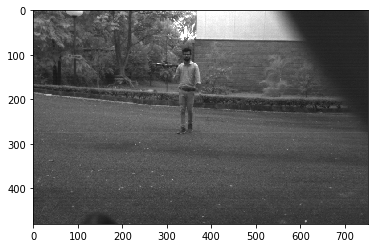



3203.9361776116966


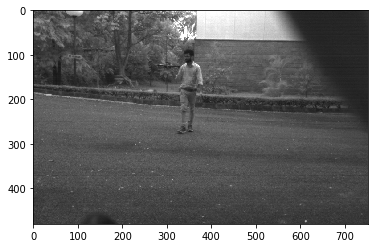



3112.395143965648


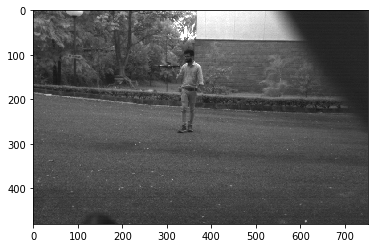



3301.0251526908387


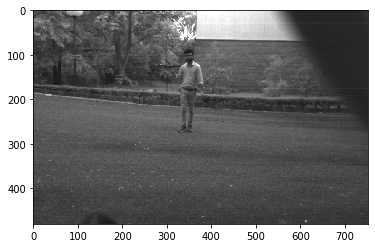



3301.0251526908387


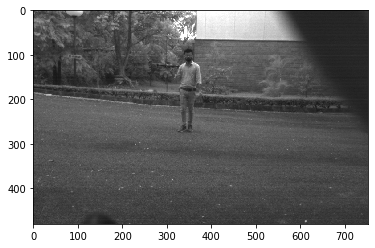



3513.9945173805704


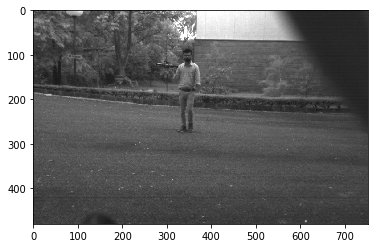



3404.1821887124274


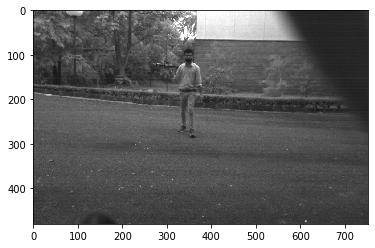



3112.395143965648


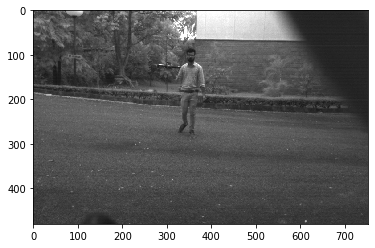



3025.9397232999354


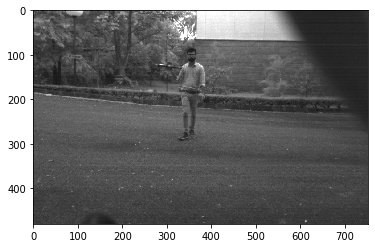



2944.1575686161536


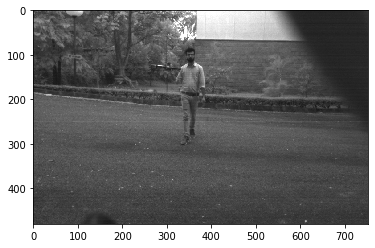



2656.9226838731142


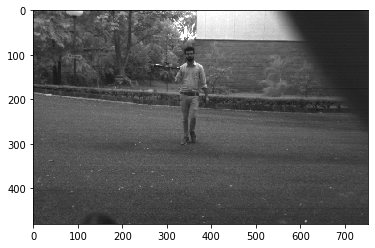



2533.344884623202


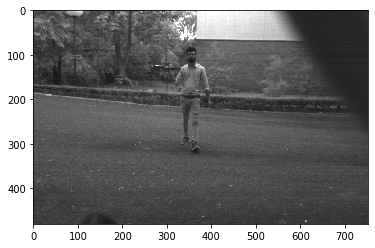



2475.7688645181292


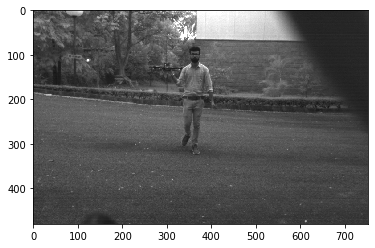



2420.7517786399485


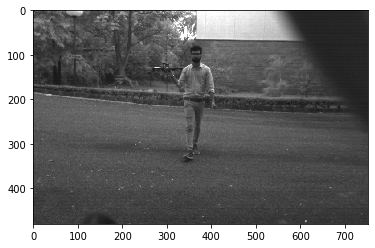



2368.1267399738626


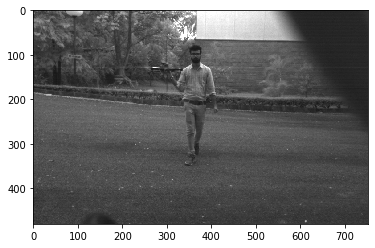



2317.74106465527


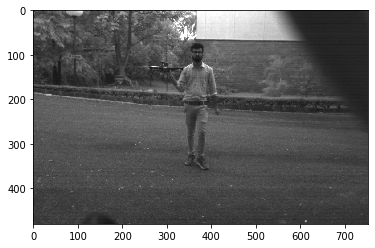



1980.6150916145032


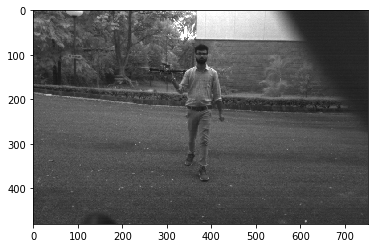



2055.3552837508996


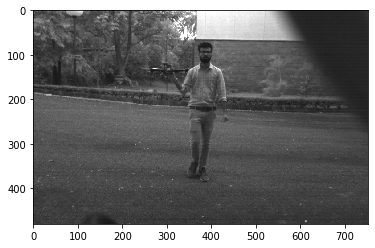



2017.2931488666236


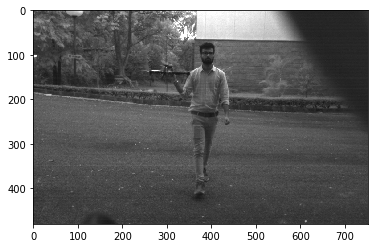



1601.9680888058483


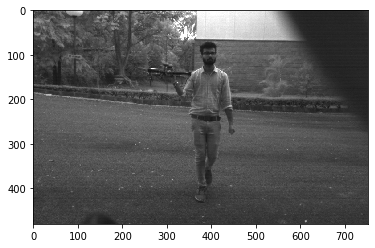



1675.9050775199644


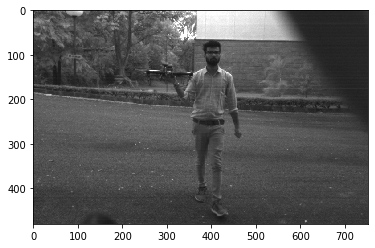



1534.279296321094


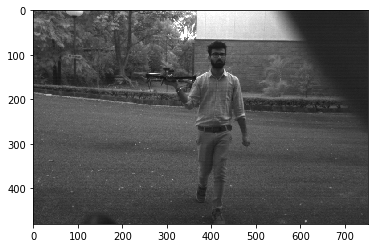



1452.4510671839691


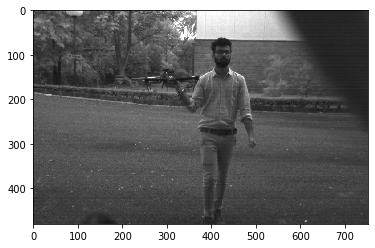



1252.1129889516974


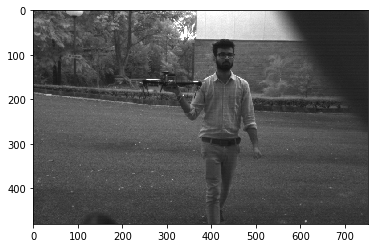



1134.727396237476


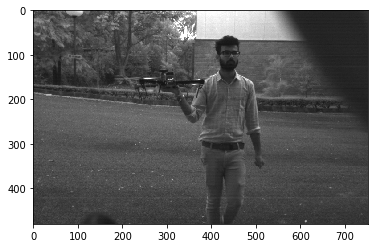



1027.6776418754498


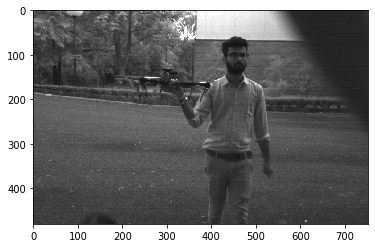



900.2795870975015


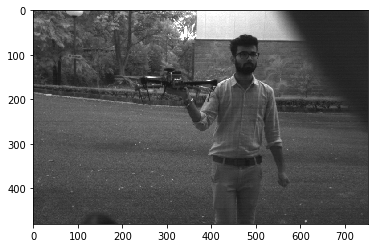



844.4482948744006


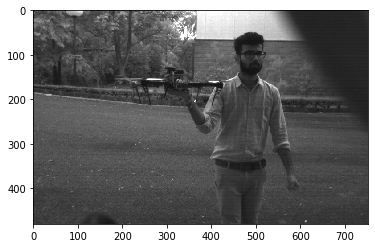



825.2562881727097


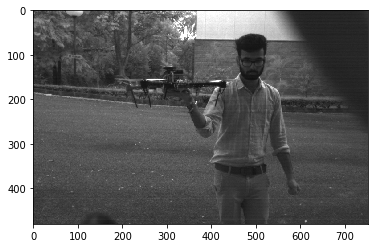



885.6408946243714


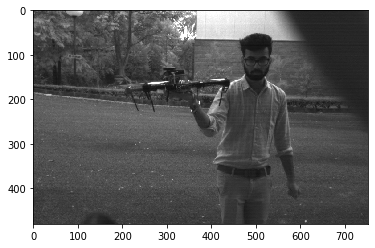



819.0513536751705


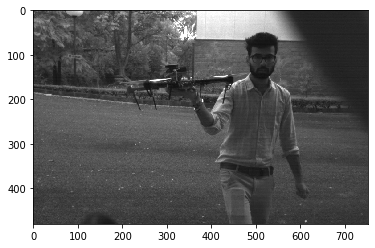



767.139648160547


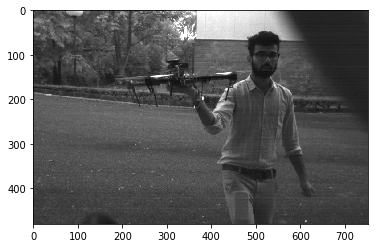



789.3755799912875


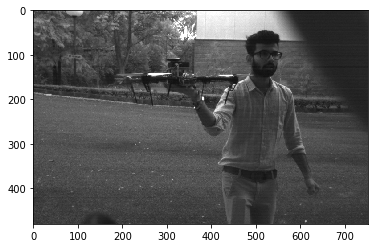



761.7750352363474


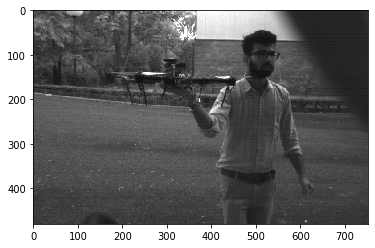



736.0393921540384


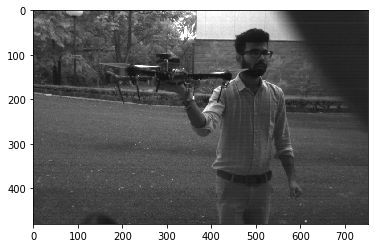



731.0995304617294


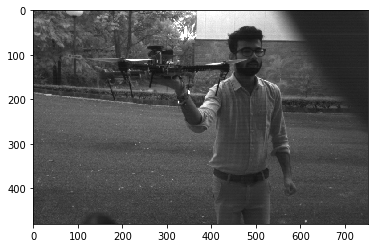



789.3755799912875


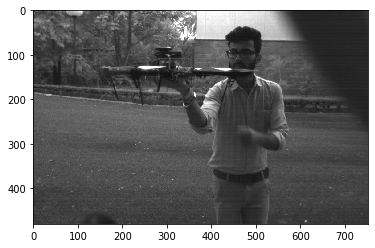



1047.4406734499776


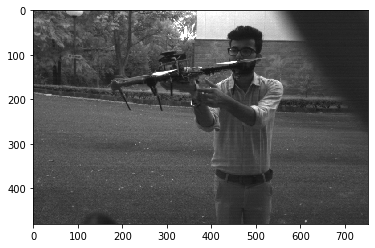



864.5542066571244


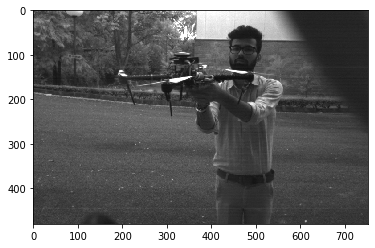



931.0583763999801


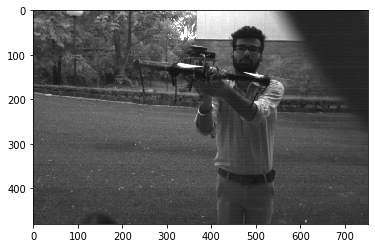



1027.6776418754498


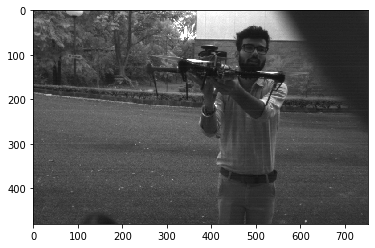



931.0583763999801


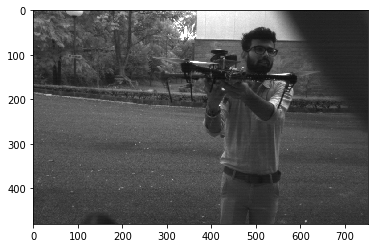



871.4706403103814


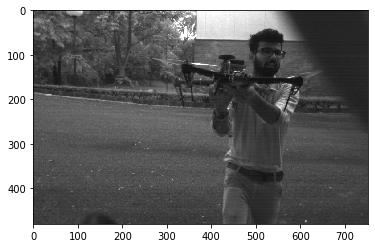



864.5542066571244


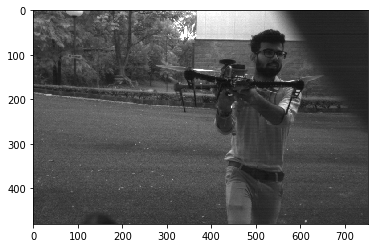



907.7819169899807


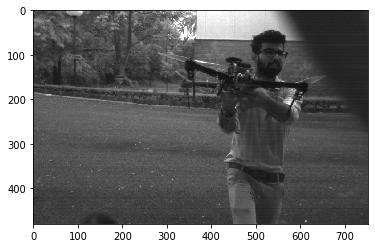



812.9390301402811


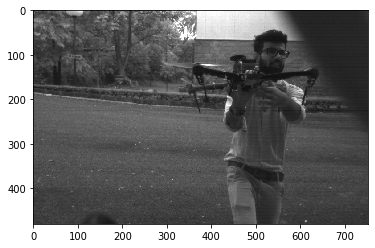



864.5542066571244


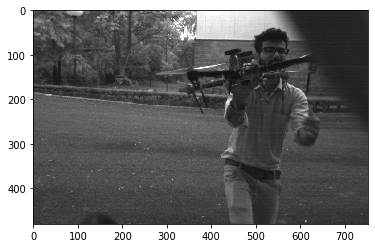



812.9390301402811


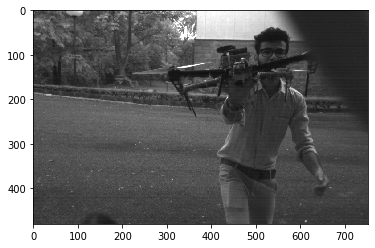



819.0513536751705


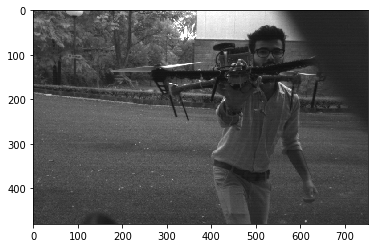



844.4482948744006


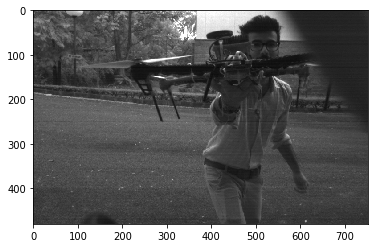



746.1221235534088


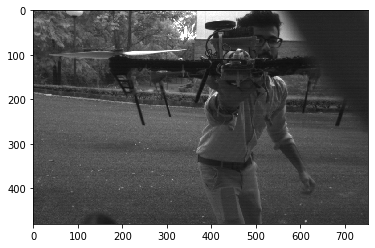



756.4849308249838


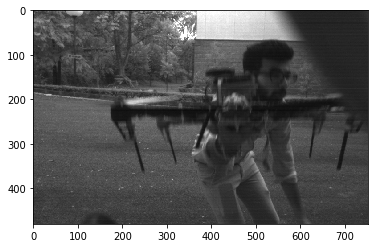



885.6408946243714


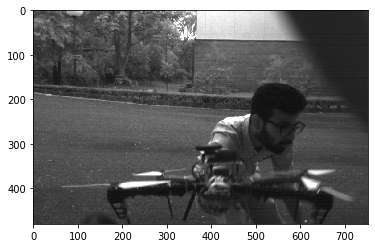



789.3755799912875


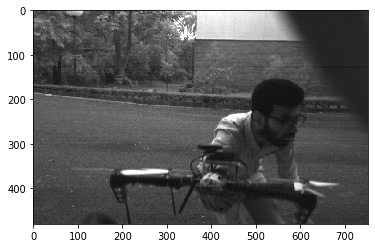



506.6689769246404


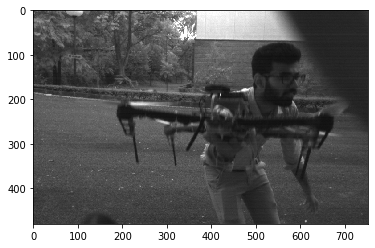



644.578875969217


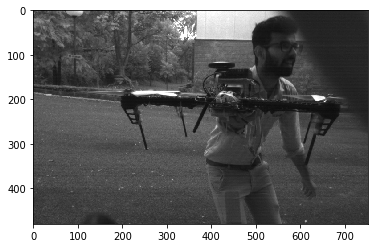



539.2763863306816


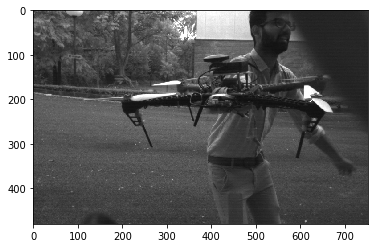



479.88471382730256


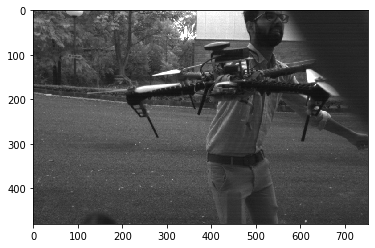



495.1537729036258


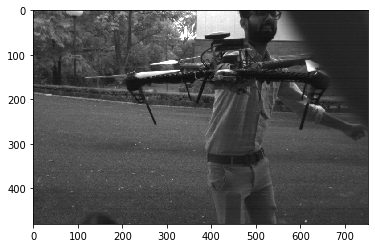



831.5559544946387


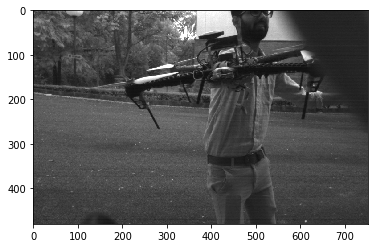



592.0316849934657


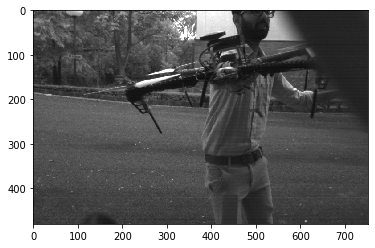



772.58035488509


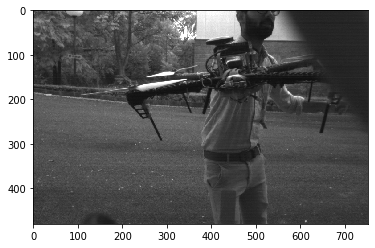



509.0365889663443


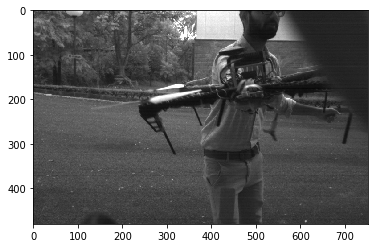



No Object


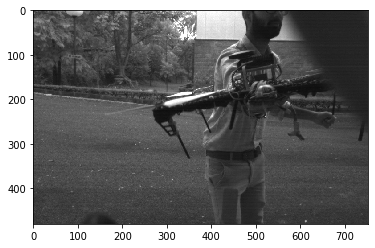



1288.742926109187


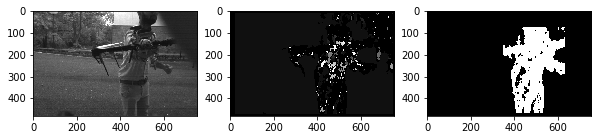



1376.6117619802678


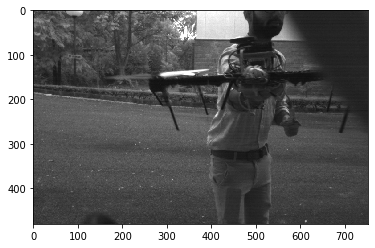



1539.9385811982656


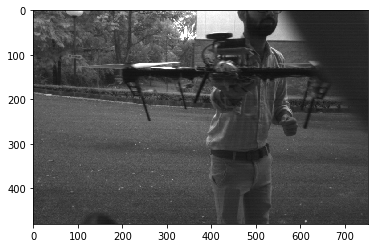



1514.2729381782947


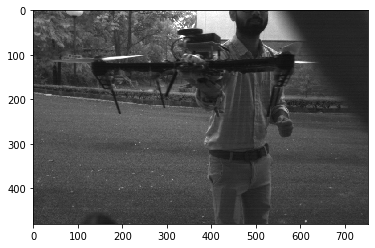



1514.2729381782947


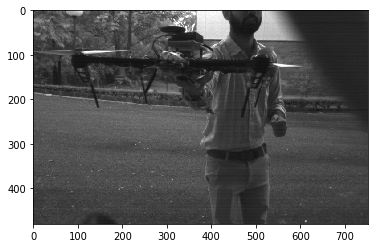



1356.0653177716072


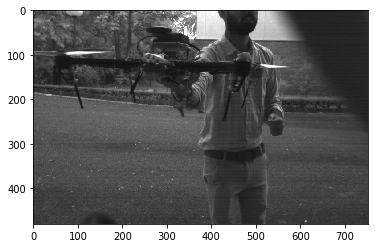



1336.123180745554


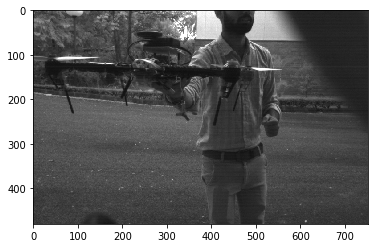



1453.702020651163


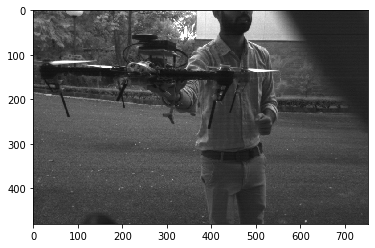



1376.6117619802678


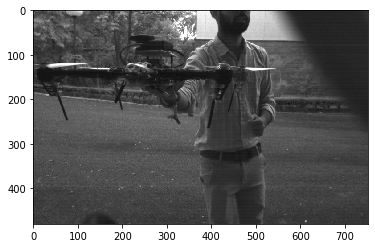



1430.809075444058


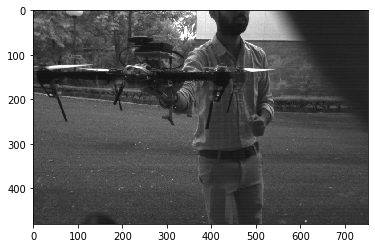



1442.1647030269473


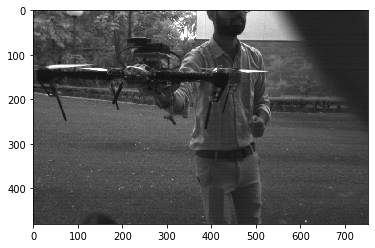



1261.8941151485787


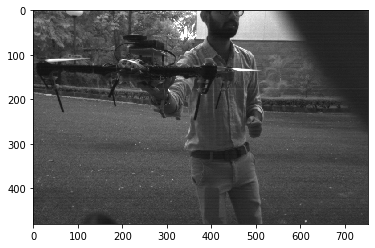



1307.2859897942112


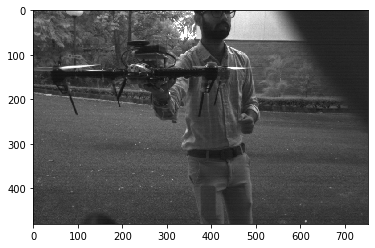



1489.4487916507817


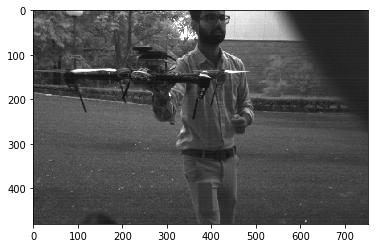



1764.2014813727703


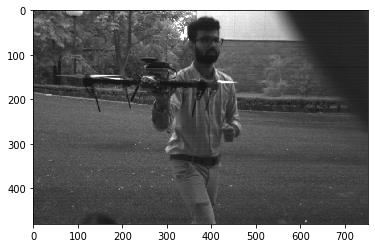



1698.2500241251903


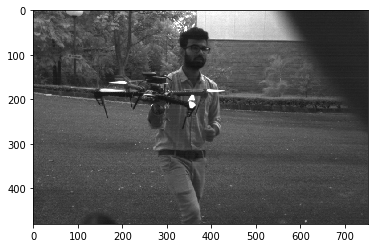



2216.0091778218944


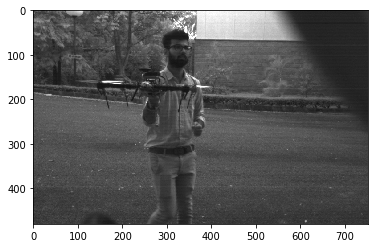



2041.7163211392735


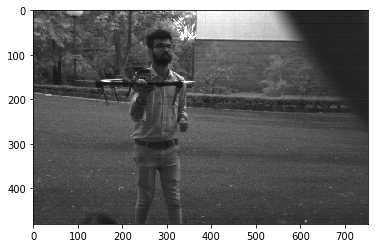



2189.3102720650045


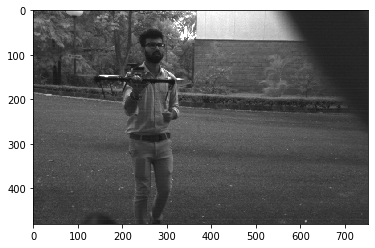



2455.5777375864236


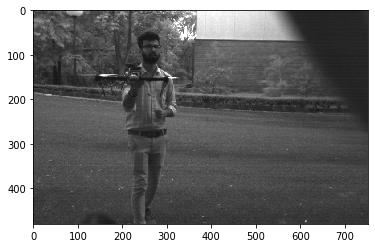



2489.2157887862377


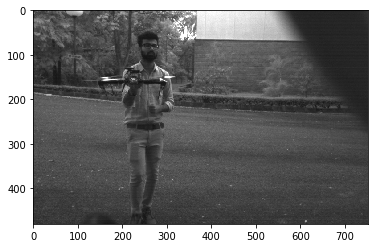



2359.905877680459


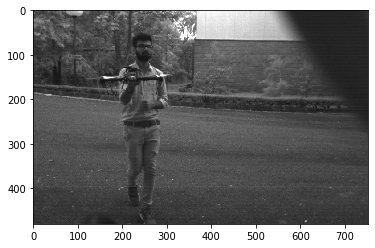



2300.161425080954


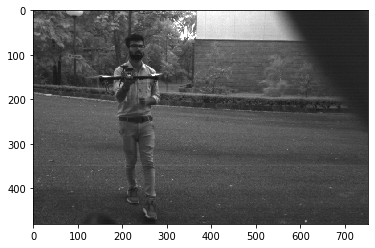



2216.0091778218944


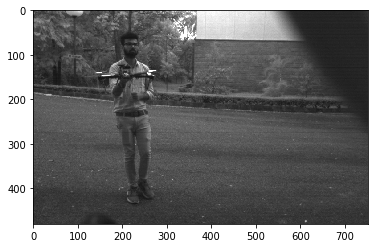



2595.896465448505


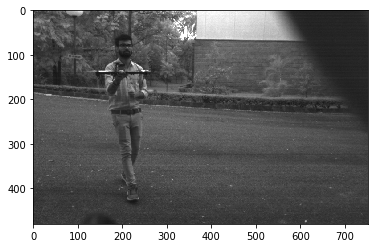



2633.518153353556


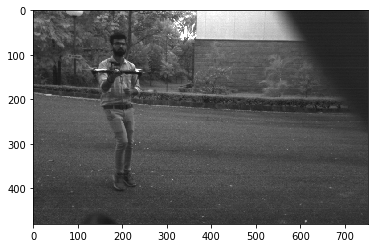



2559.334543399935


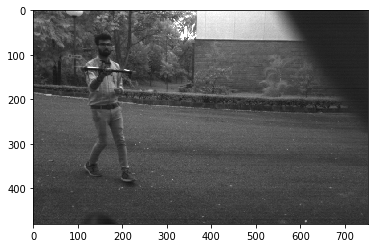



2489.2157887862377


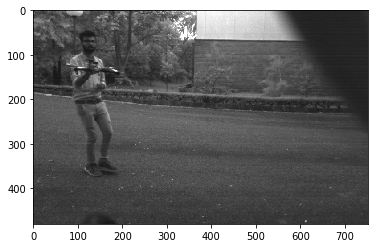



2523.7882302971575


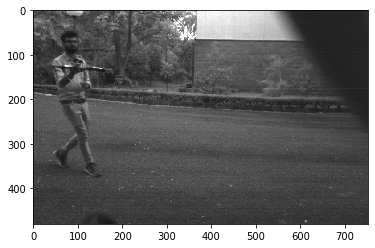



2884.3294060538947


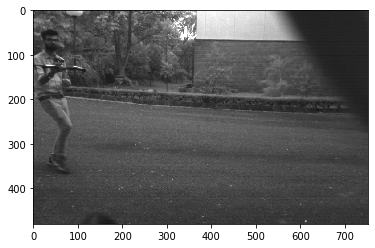



4225.877967009194


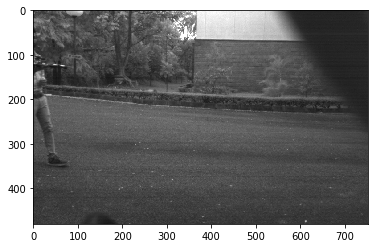



No Object


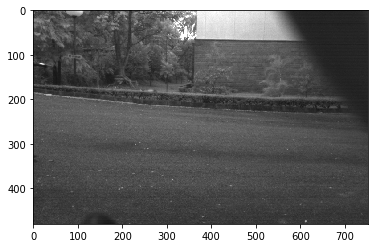



No Object


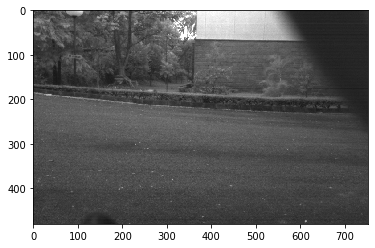



No Object


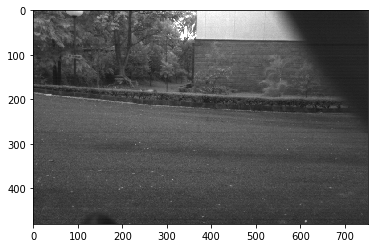



No Object


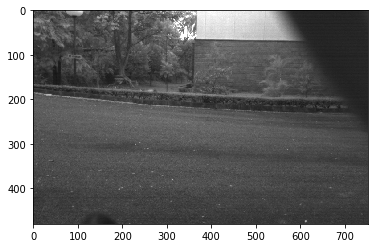



No Object


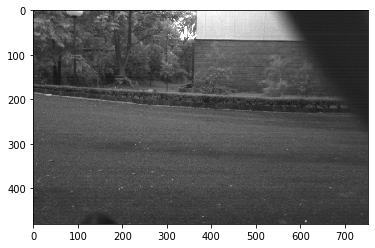



No Object


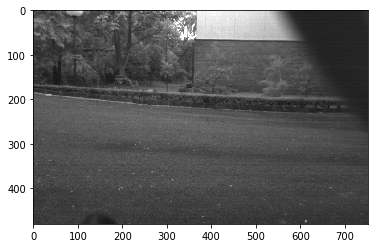



No Object


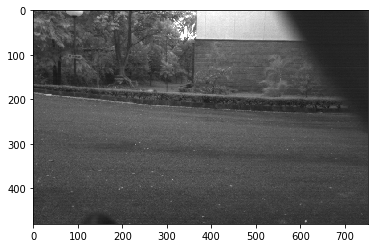



No Object


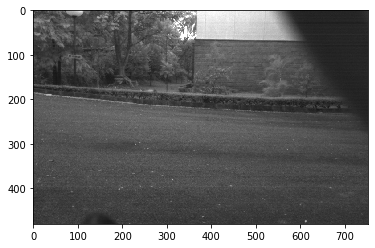



No Object


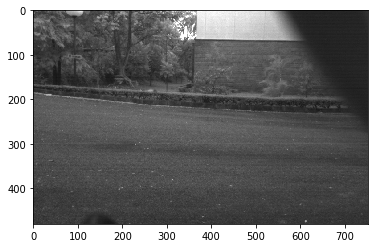



No Object


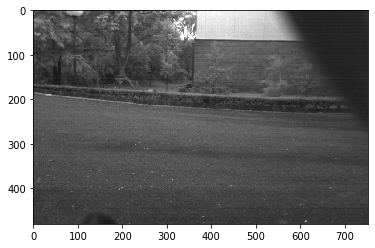



No Object


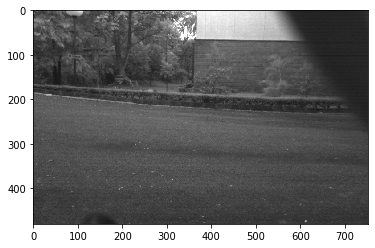



No Object


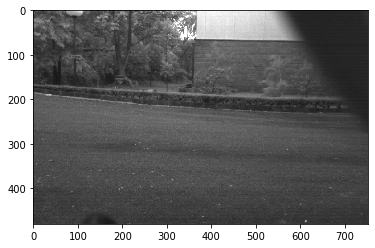



Object only in Right Camera


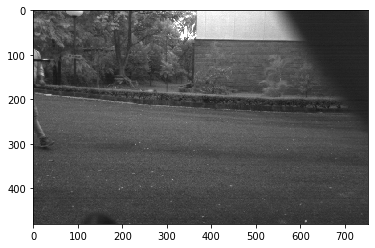



1396.4724028697863


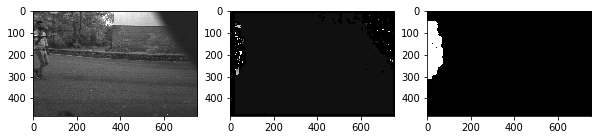



930.9816019131908


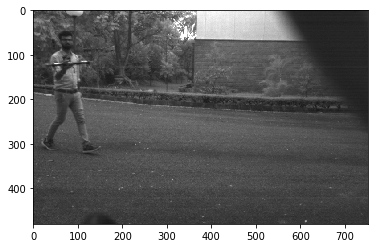



1212.0326515473616


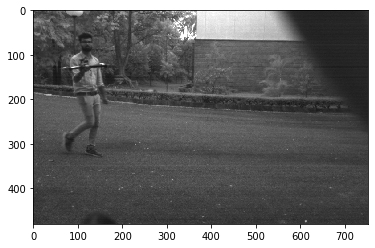



1107.5470781381064


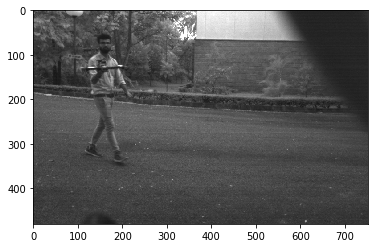



1167.9587369456394


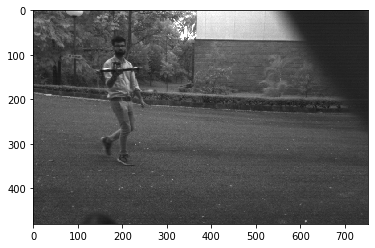



1167.9587369456394


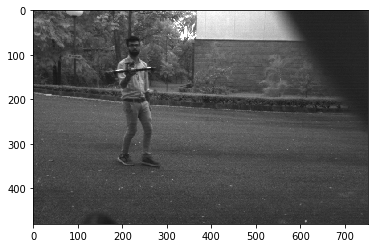



1259.5633437649053


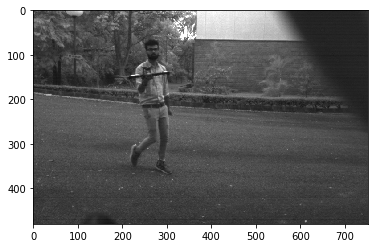



1088.7750937628841


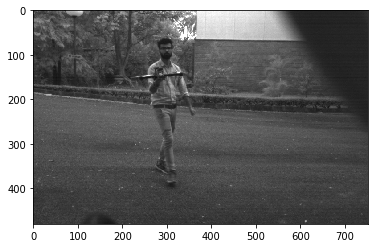



1107.5470781381064


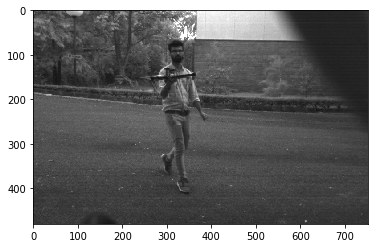



1167.9587369456394


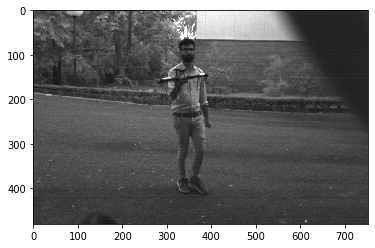



958.772097492689


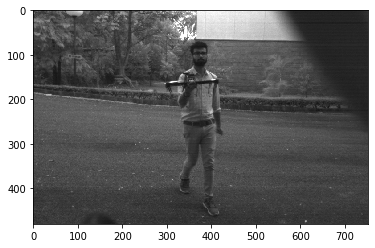



813.135829519116


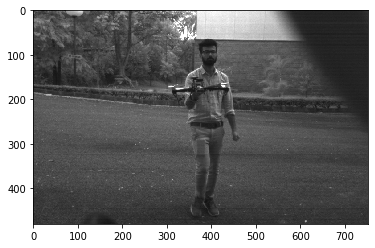



793.0584016297552


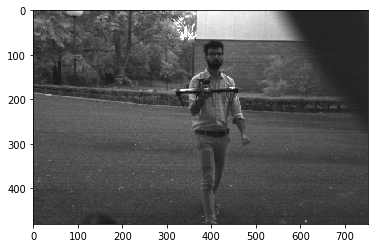



856.5030737601355


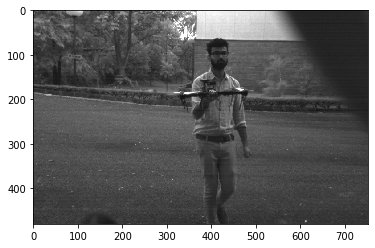



773.9485606266285


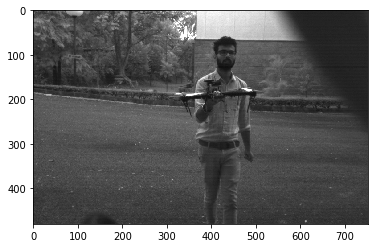



669.1430263751059


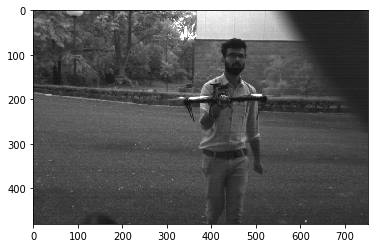



578.7182930811726


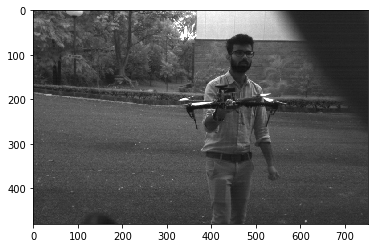



553.7735390690532


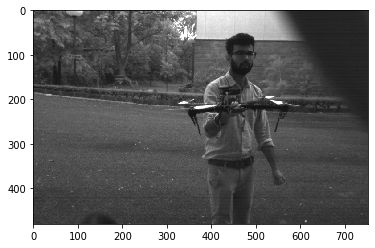



535.3144211000847


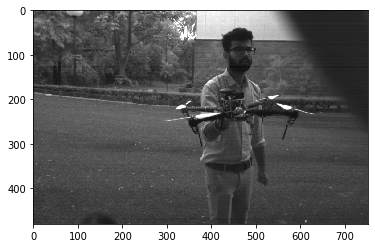



535.3144211000847


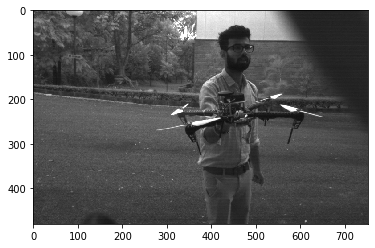



530.8903349752907


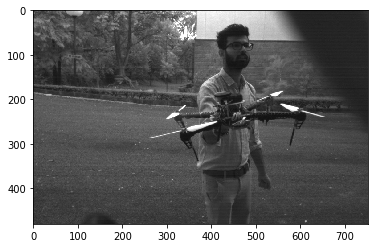



589.3369773578914


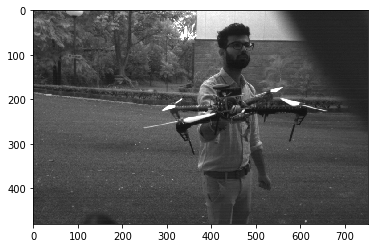



629.7816718824527


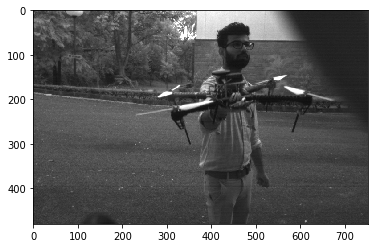



583.9793684728197


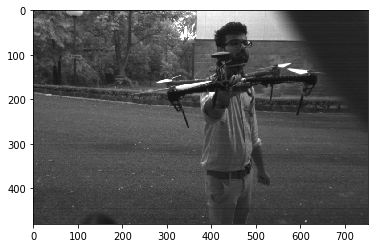



606.0163257736808


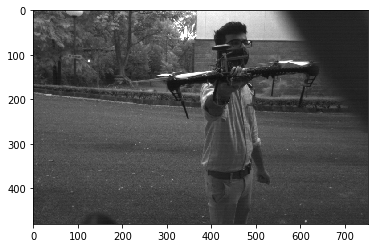



583.9793684728197


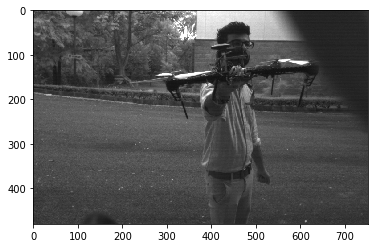



600.3526217944875


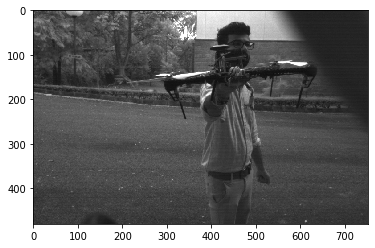



655.4870462450017


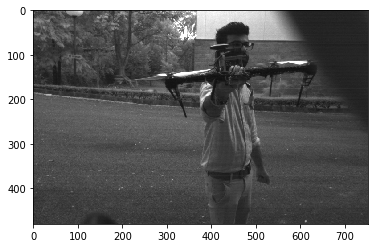



648.8659649697996


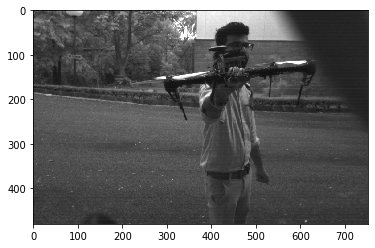



544.3875468814421


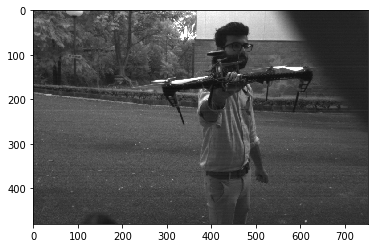



539.8128616135308


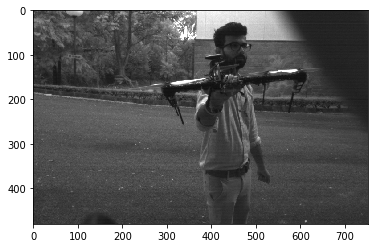



573.5511654643765


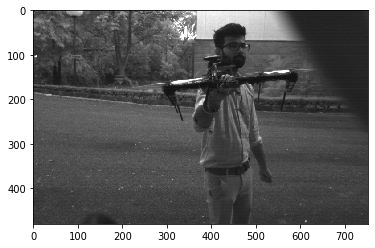



563.4888643158787


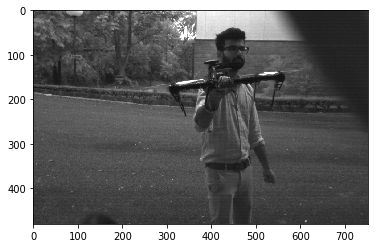



589.3369773578914


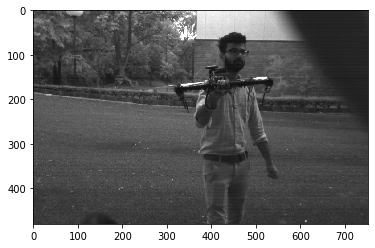



594.7938012223163


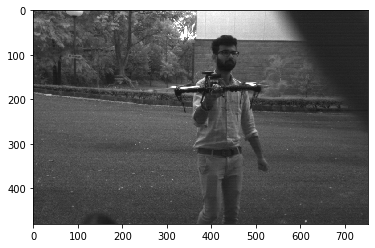



713.7525614667796


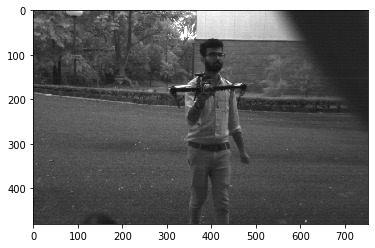



755.7380062589431


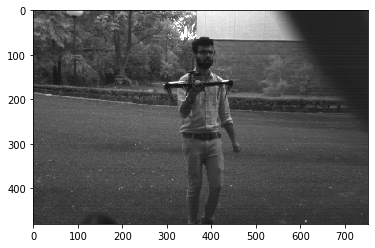



868.077439621759


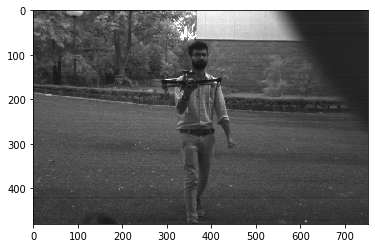



904.7567680564812


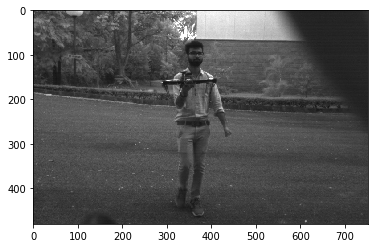



1003.7145395626588


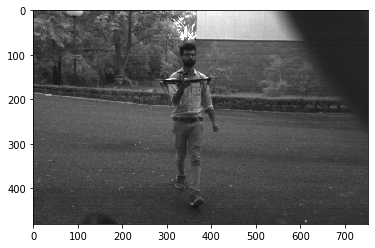



1167.9587369456394


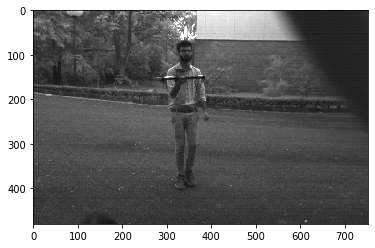



1310.9740924900034


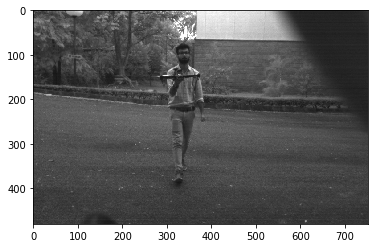



1310.9740924900034


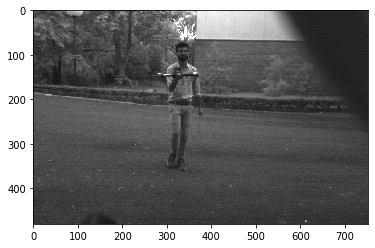



1427.5051229335593


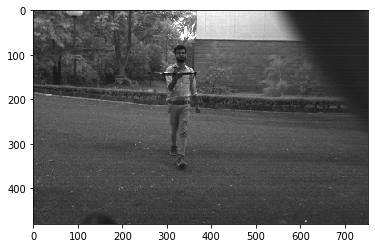



1647.1212956925683


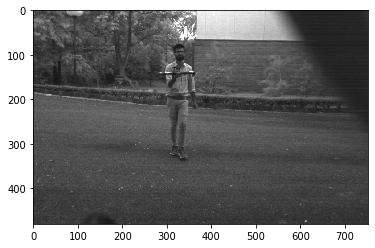



1529.4697745716705


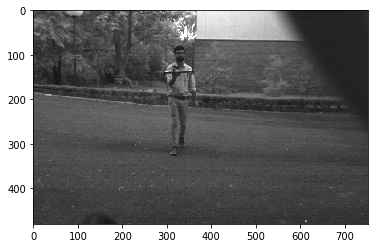



1566.7739154148821


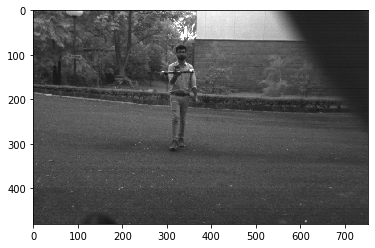



1690.466592947636


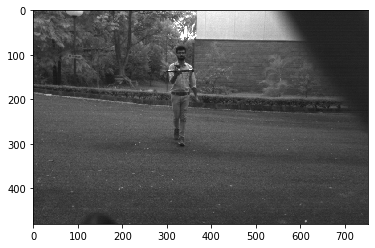



1736.154879243518


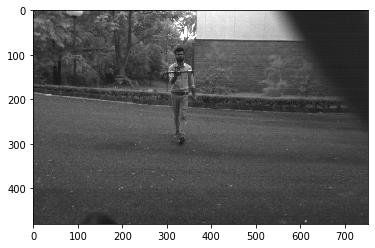



1889.3450156473577


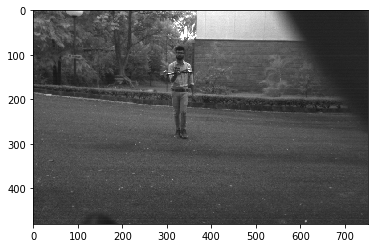



1889.3450156473577


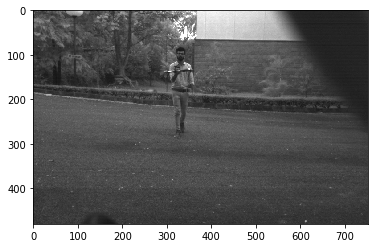



2007.4290791253177


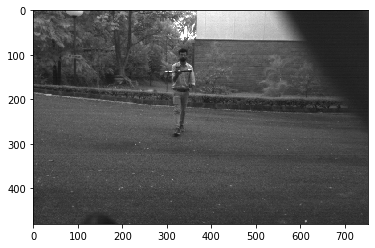



2072.184855871296


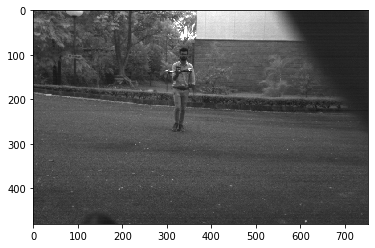



2141.257684400339


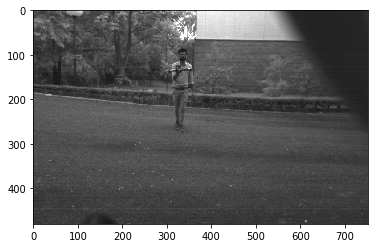



2215.0941562762127


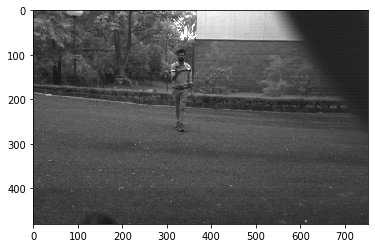



2215.0941562762127


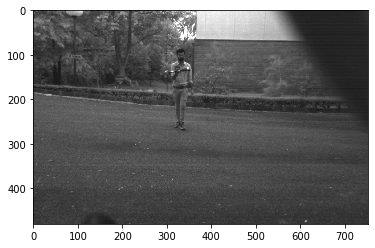



2072.184855871296


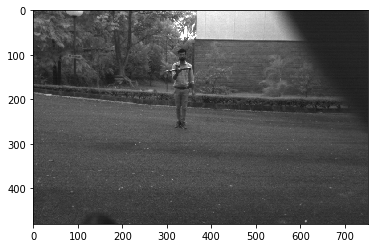



2072.184855871296


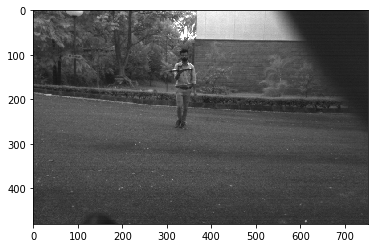



2072.184855871296


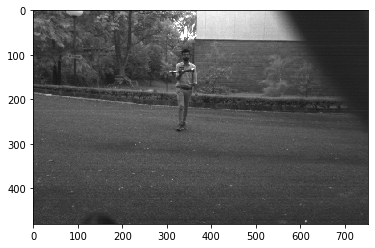



2072.184855871296


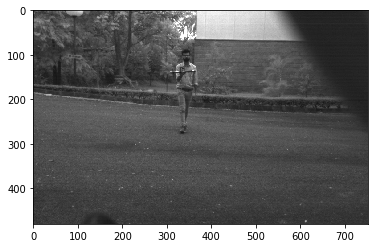



2215.0941562762127


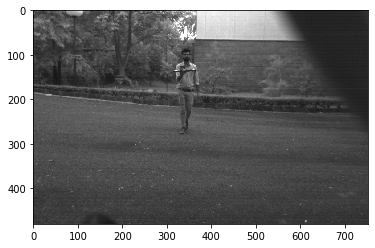



2379.1752048892654


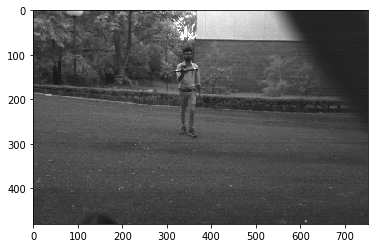



2072.184855871296


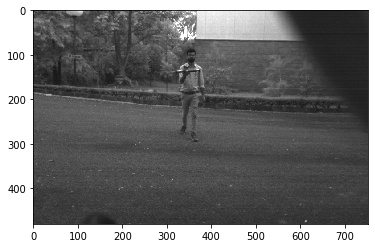



1690.466592947636


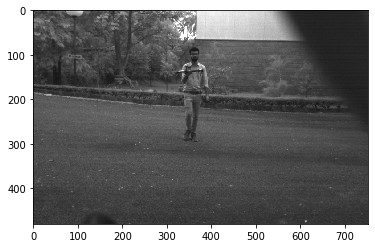



1736.154879243518


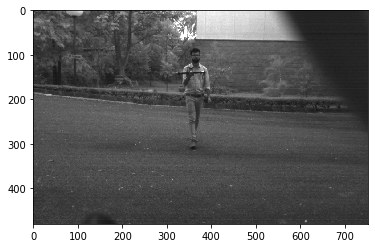



1736.154879243518


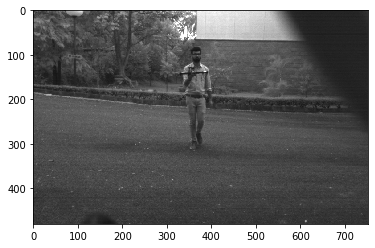



1647.1212956925683


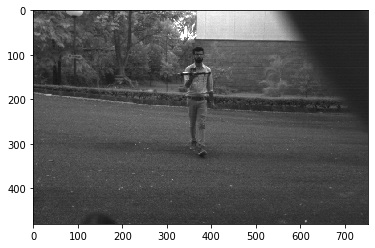



1427.5051229335593


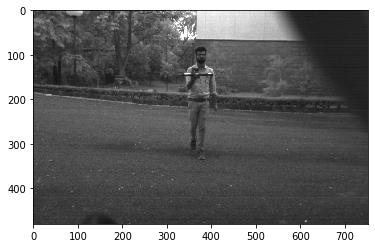



1396.4724028697863


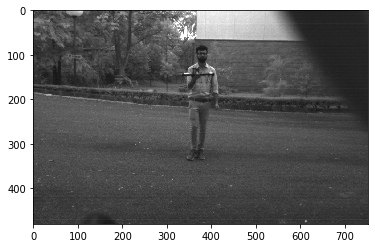



1310.9740924900034


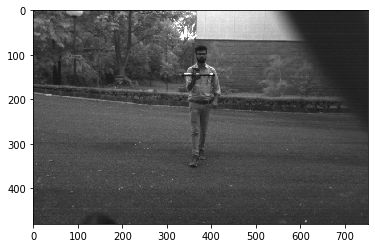



1427.5051229335593


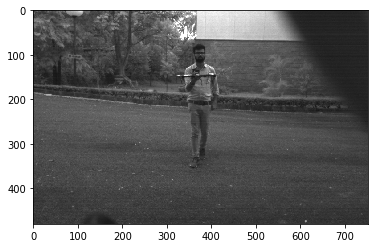



1366.7602240853228


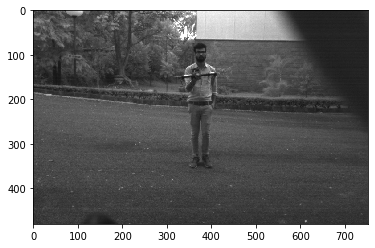



1212.0326515473616


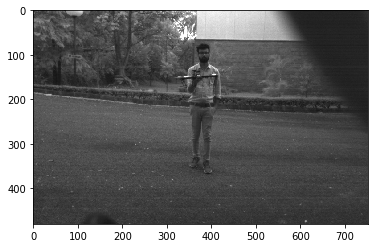



1235.3409717694262


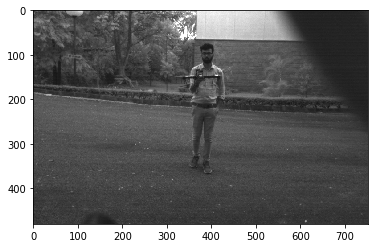



1259.5633437649053


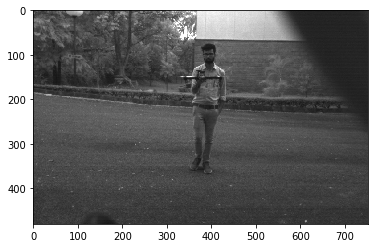



1284.7546106402033


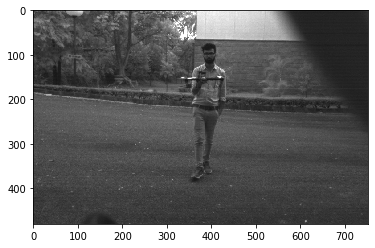



1310.9740924900034


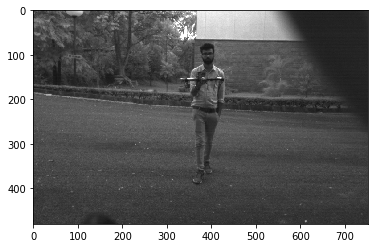



1310.9740924900034


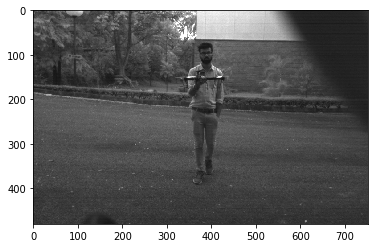



1284.7546106402033


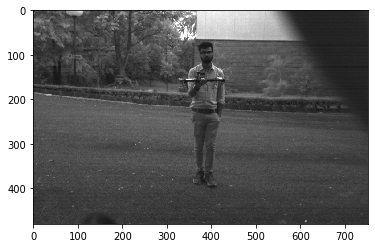



1235.3409717694262


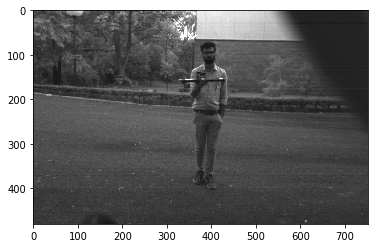



1235.3409717694262


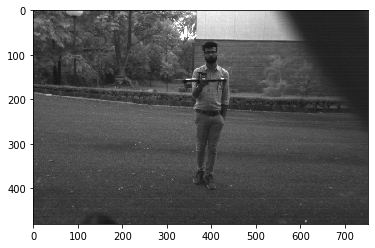



1235.3409717694262


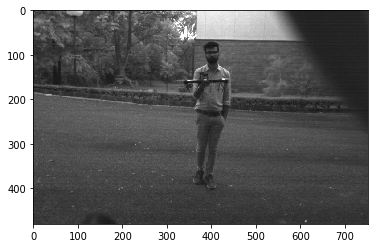



1235.3409717694262


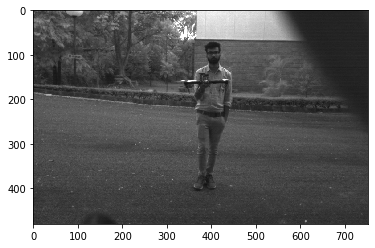



1235.3409717694262


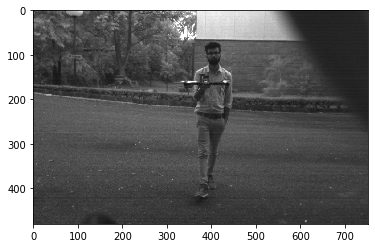



1189.5876024446327


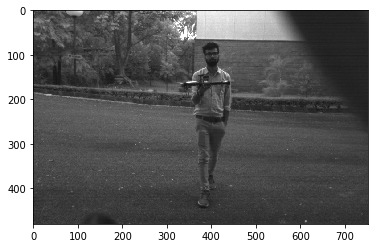



944.6725078236789


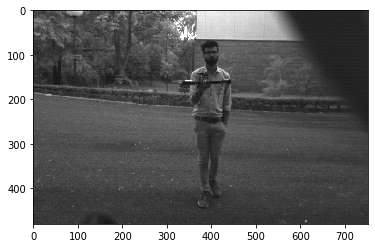



1167.9587369456394


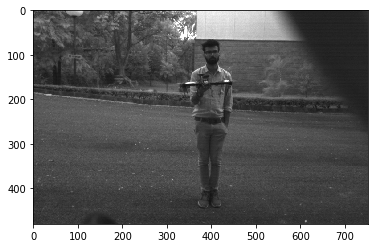



1147.102330928753


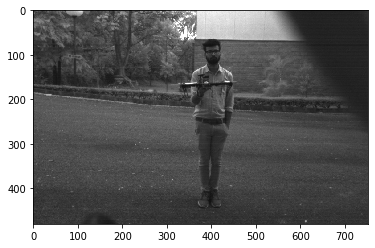



958.772097492689


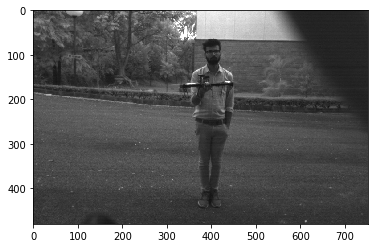



930.9816019131908


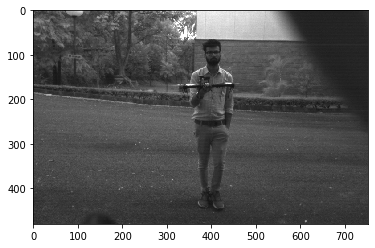



973.2989474546995


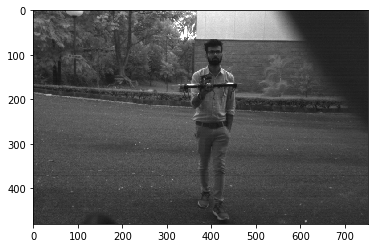



958.772097492689


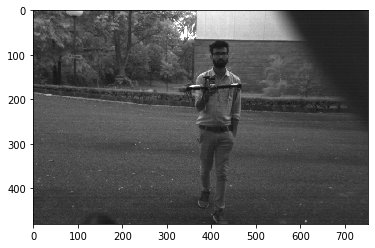



944.6725078236789


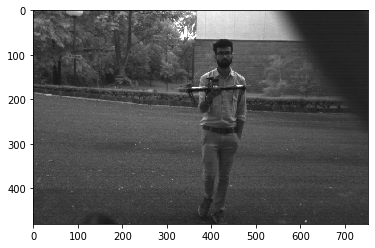



917.6818647430024


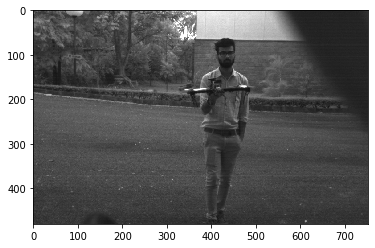



892.1907018334746


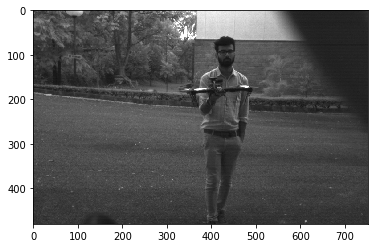



904.7567680564812


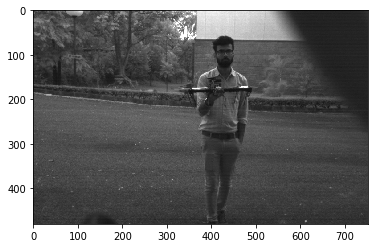



904.7567680564812


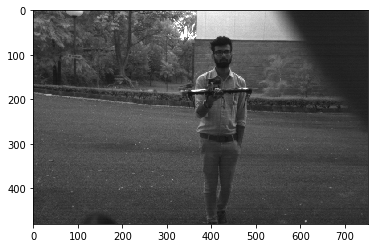



856.5030737601355


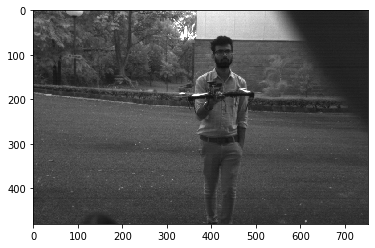



783.3869577074411


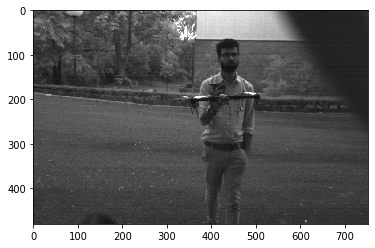



713.7525614667796


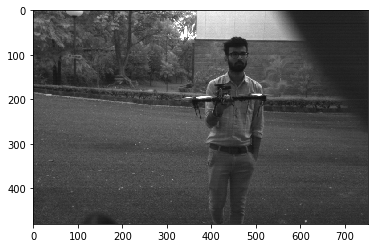



713.7525614667796


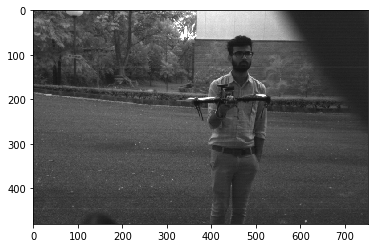



729.9742105910246


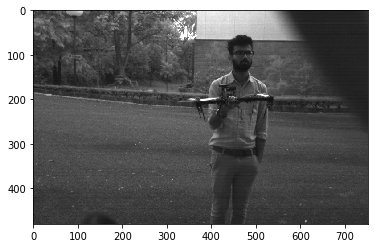



698.2362014348931


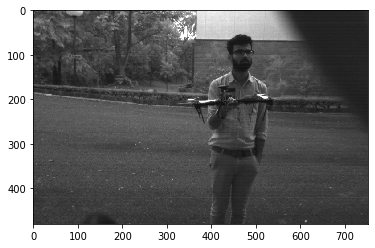



705.9091267253864


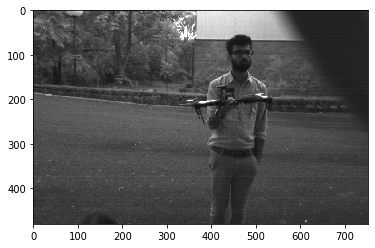



690.7282852904319


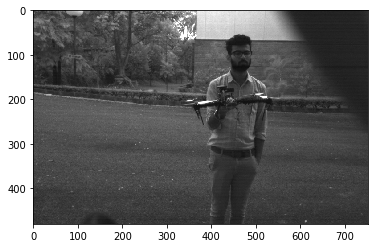



698.2362014348931


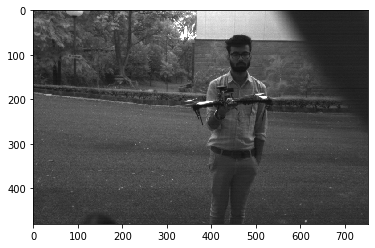



669.1430263751059


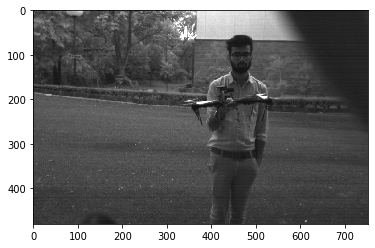



669.1430263751059


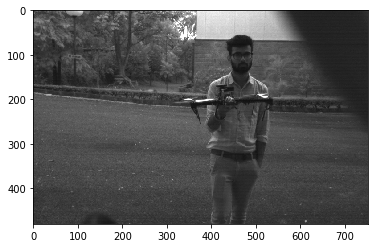



636.0171339802987


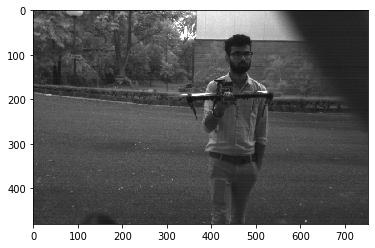



623.6672867185453


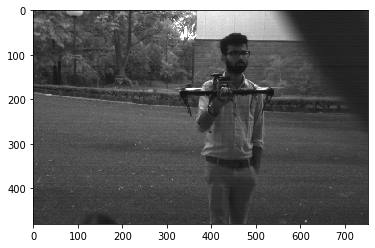



558.5889611479145


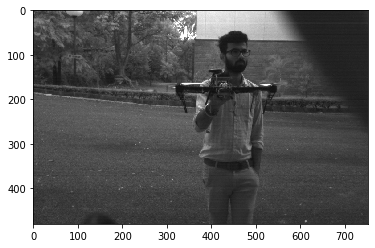



573.5511654643765


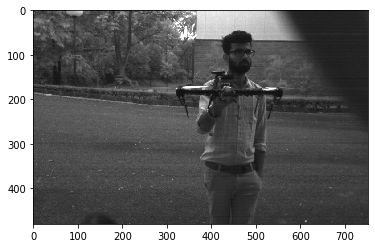



611.7879098286683


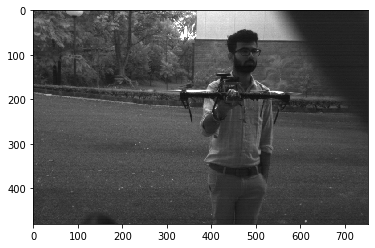



568.4754914337183


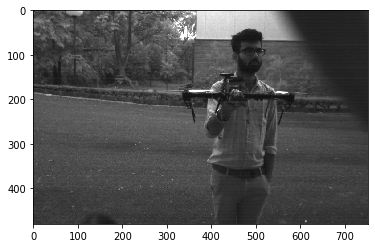



606.0163257736808


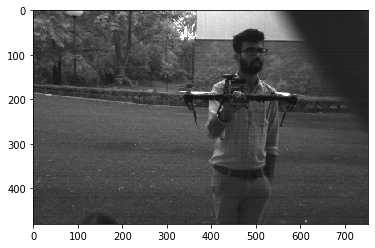



600.3526217944875


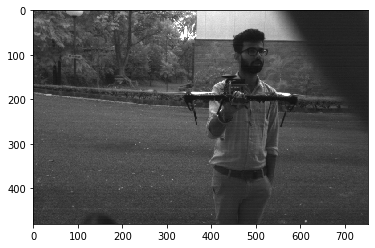



594.7938012223163


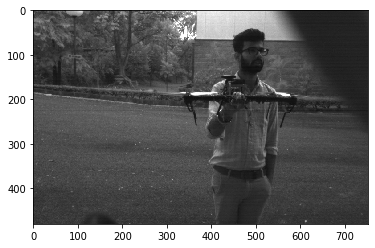



578.7182930811726


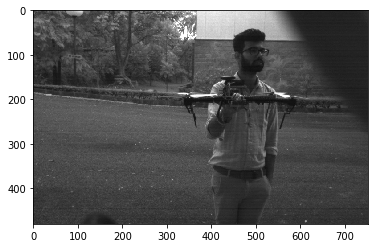



573.5511654643765


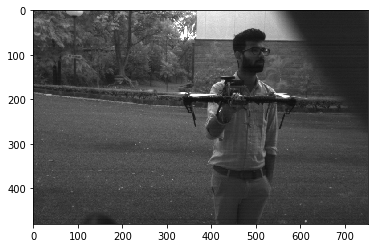



568.4754914337183


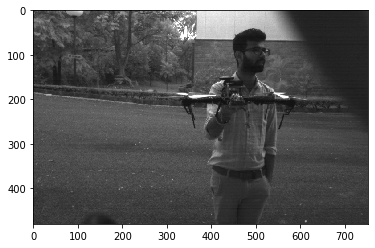



544.3875468814421


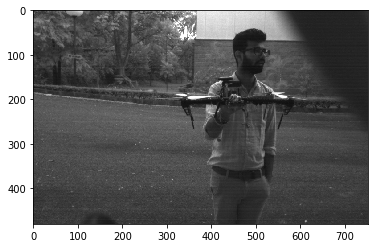



544.3875468814421


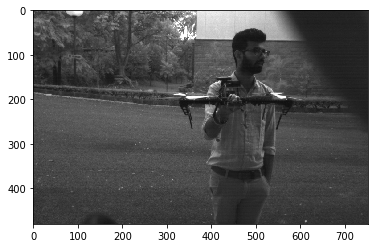



558.5889611479145


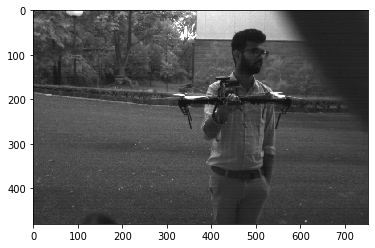



518.046213967824


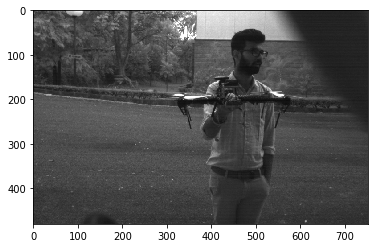



505.8089018268517


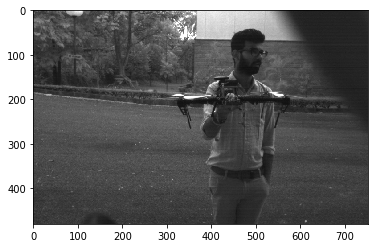



505.8089018268517


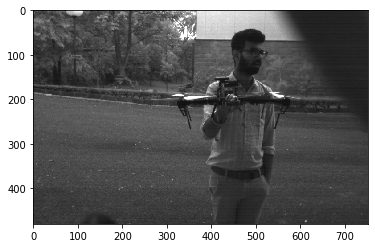



522.2579718049607


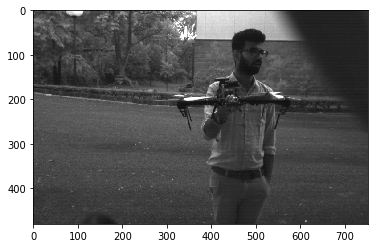



513.9018442560813


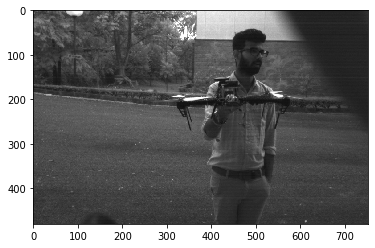



509.8232581905569


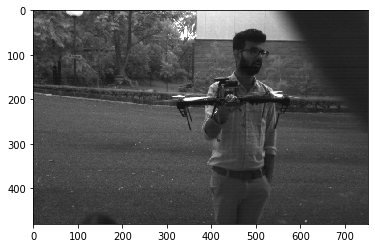



578.7182930811726


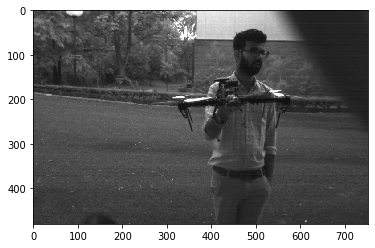



518.046213967824


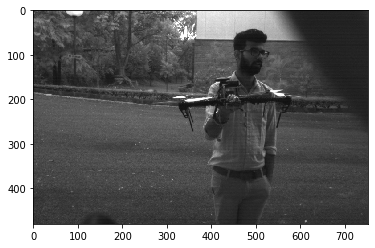



544.3875468814421


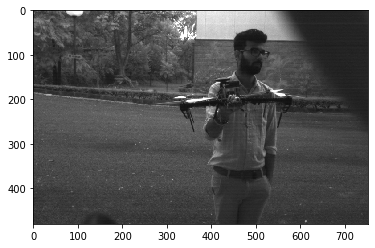



482.990455127896


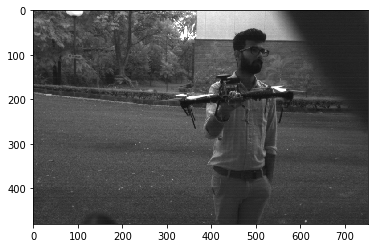



589.3369773578914


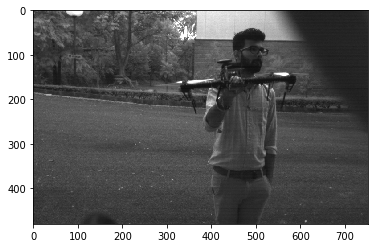



568.4754914337183


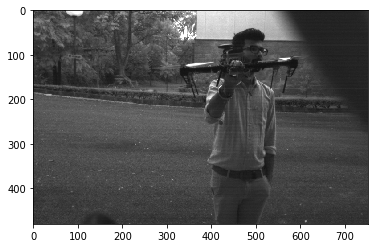



655.4870462450017


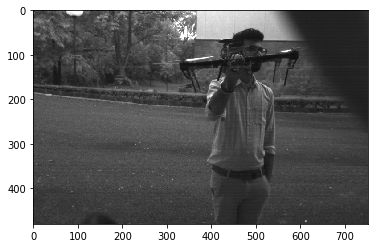



648.8659649697996


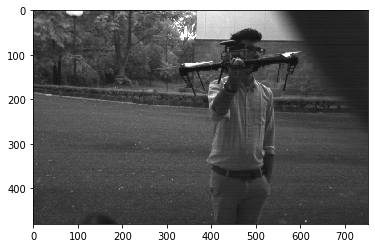



683.3801120426614


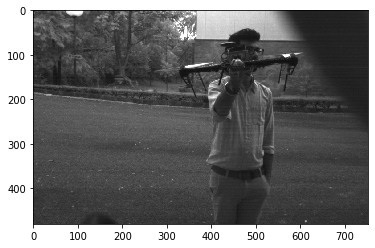



655.4870462450017


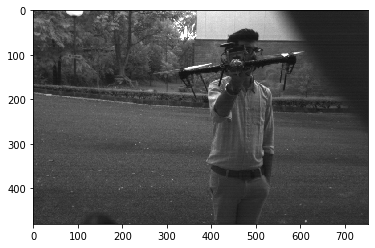



683.3801120426614


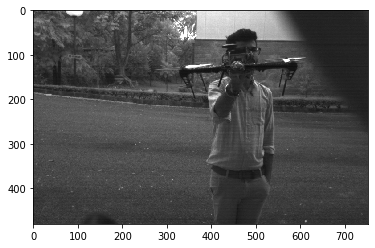



690.7282852904319


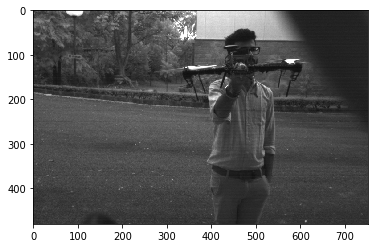



705.9091267253864


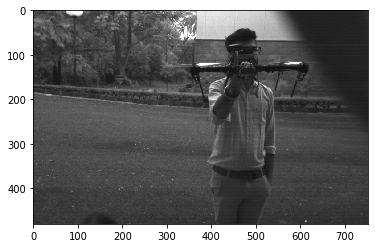



655.4870462450017


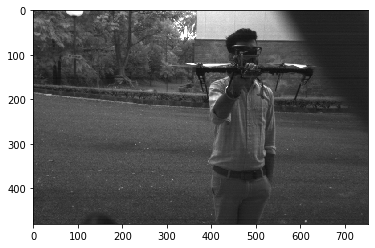



655.4870462450017


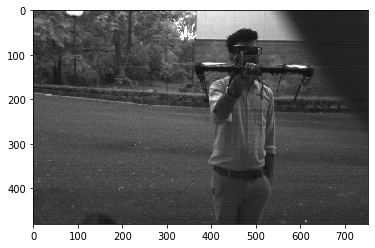



705.9091267253864


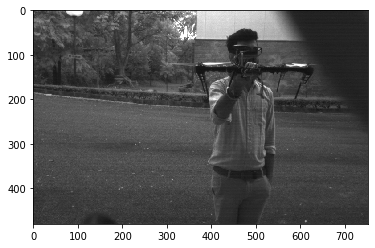



705.9091267253864


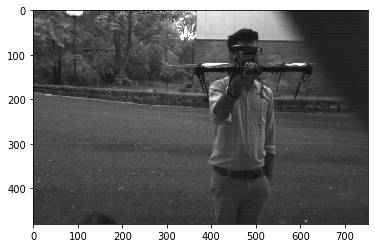



690.7282852904319


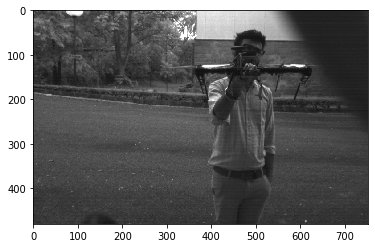



662.2446446598987


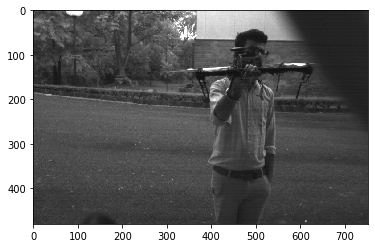



676.1866371790544


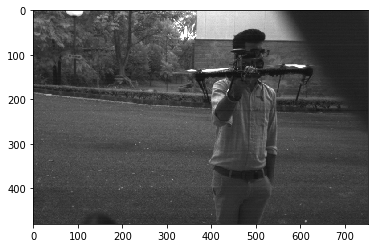



617.6704858847131


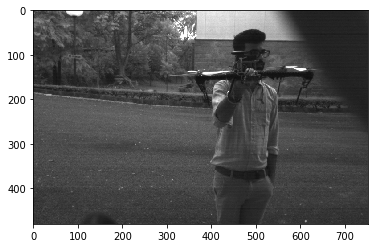



617.6704858847131


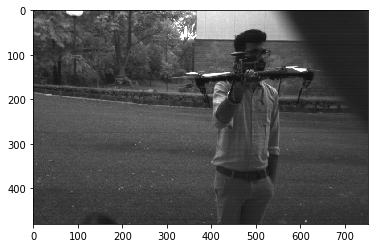



568.4754914337183


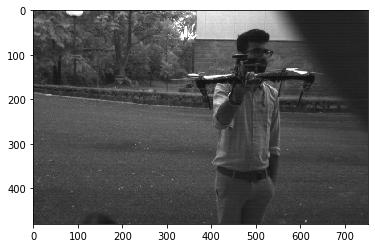



509.8232581905569


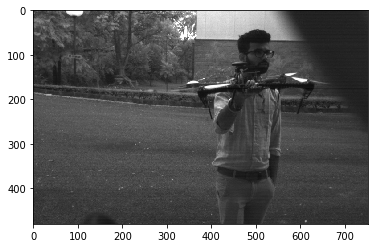



563.4888643158787


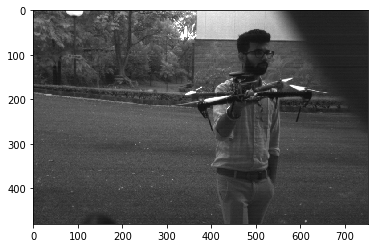



583.9793684728197


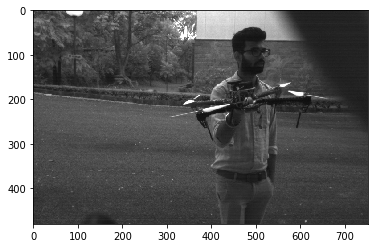



563.4888643158787


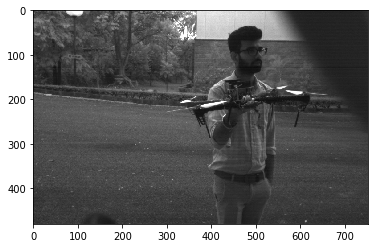



530.8903349752907


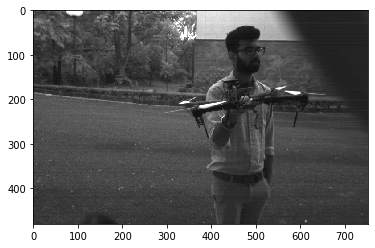



539.8128616135308


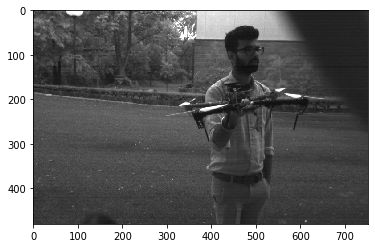



475.83504097785305


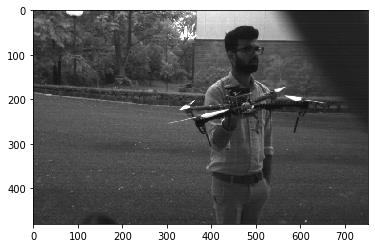



539.8128616135308


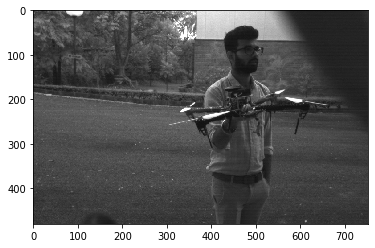



539.8128616135308


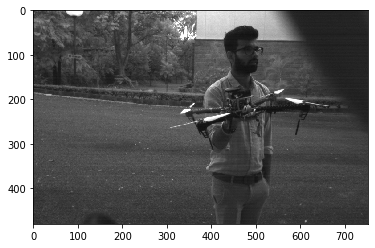

In [8]:
start = time.time()
depth()
end = time.time()

In [9]:
seconds = end - start
seconds

659.7102859020233

In [10]:
fps = len(files)/seconds
fps

0.6139058442089358